# ***Imports***

In [1]:
!pip install kmodes
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import scipy.stats as stats
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer
from kmodes.kmodes import KModes
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.colors
from yellowbrick.cluster import KElbowVisualizer
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import davies_bouldin_score
from sklearn.ensemble import RandomForestClassifier
import plotly.express as px

In [2]:
# from google.colab import drive
# drive.mount('/content/drive')

# ***Loading the Data Set***

In [3]:
df = pd.read_csv('loan_approval_dataset.csv')

In [4]:
df.columns = df.columns.str.strip()

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   loan_id                   4269 non-null   int64 
 1   no_of_dependents          4269 non-null   int64 
 2   education                 4269 non-null   object
 3   self_employed             4269 non-null   object
 4   income_annum              4269 non-null   int64 
 5   loan_amount               4269 non-null   int64 
 6   loan_term                 4269 non-null   int64 
 7   cibil_score               4269 non-null   int64 
 8   residential_assets_value  4269 non-null   int64 
 9   commercial_assets_value   4269 non-null   int64 
 10  luxury_assets_value       4269 non-null   int64 
 11  bank_asset_value          4269 non-null   int64 
 12  loan_status               4269 non-null   object
dtypes: int64(10), object(3)
memory usage: 433.7+ KB


# ***Encoding the Object data to Integers***

In [6]:
education_mapping = {' Graduate': 0, ' Not Graduate': 1}
self_employed_mapping = {' No': 0, ' Yes': 1}

# Apply the mapping using the map function
df['education'] = df['education'].map(education_mapping)
df['self_employed'] = df['self_employed'].map(self_employed_mapping)

In [7]:
loan_status_mapping = {' Approved': 1, ' Rejected': 0}
df['loan_status'] = df['loan_status'].map(loan_status_mapping)

# ***Creating the Correlation Matrix***

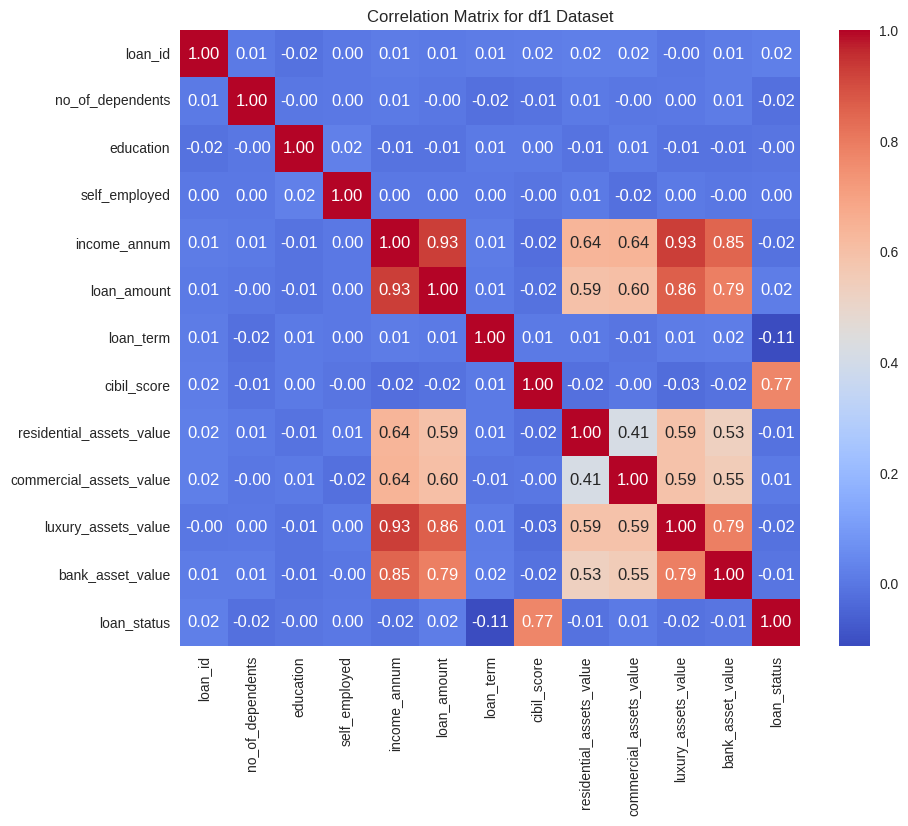

In [8]:
corr_matrix = df.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix for df1 Dataset')
plt.show()

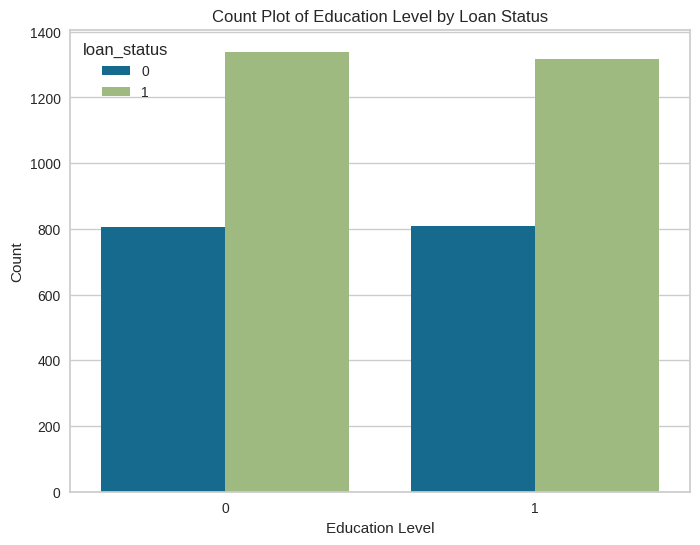

In [9]:
#Count Plot of Education Level by Loan Status
plt.figure(figsize=(8, 6))
sns.countplot(x='education', hue='loan_status', data=df)

plt.xlabel('Education Level')
plt.ylabel('Count')
plt.title('Count Plot of Education Level by Loan Status')

# Show the plot
plt.show()

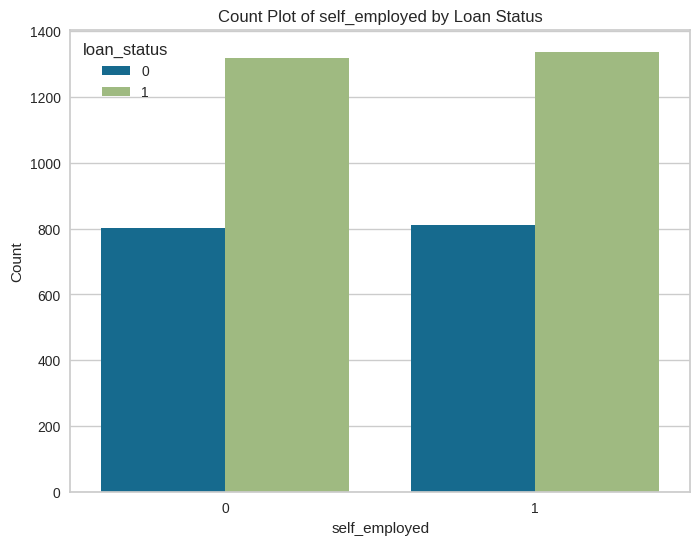

In [10]:
#Count Plot of Education Level by Loan Status
plt.figure(figsize=(8, 6))
sns.countplot(x='self_employed', hue='loan_status', data=df)

# Set labels and title
plt.xlabel('self_employed')
plt.ylabel('Count')
plt.title('Count Plot of self_employed by Loan Status')

# Show the plot
plt.show()

# ***Dropping no correlation columns***
no correlation was found between the self employed or employed columns with the approval or rejection of the loans

In [11]:
columns_to_drop = ['loan_id', 'self_employed', 'education']

# Drop the columns
df = df.drop(columns=columns_to_drop)

# ***Visualizing the distribution of each column***

array([[<Axes: ylabel='Density'>, <Axes: ylabel='Density'>,
        <Axes: ylabel='Density'>, <Axes: ylabel='Density'>,
        <Axes: ylabel='Density'>],
       [<Axes: ylabel='Density'>, <Axes: ylabel='Density'>,
        <Axes: ylabel='Density'>, <Axes: ylabel='Density'>,
        <Axes: ylabel='Density'>],
       [<Axes: ylabel='Density'>, <Axes: ylabel='Density'>,
        <Axes: ylabel='Density'>, <Axes: ylabel='Density'>,
        <Axes: ylabel='Density'>]], dtype=object)

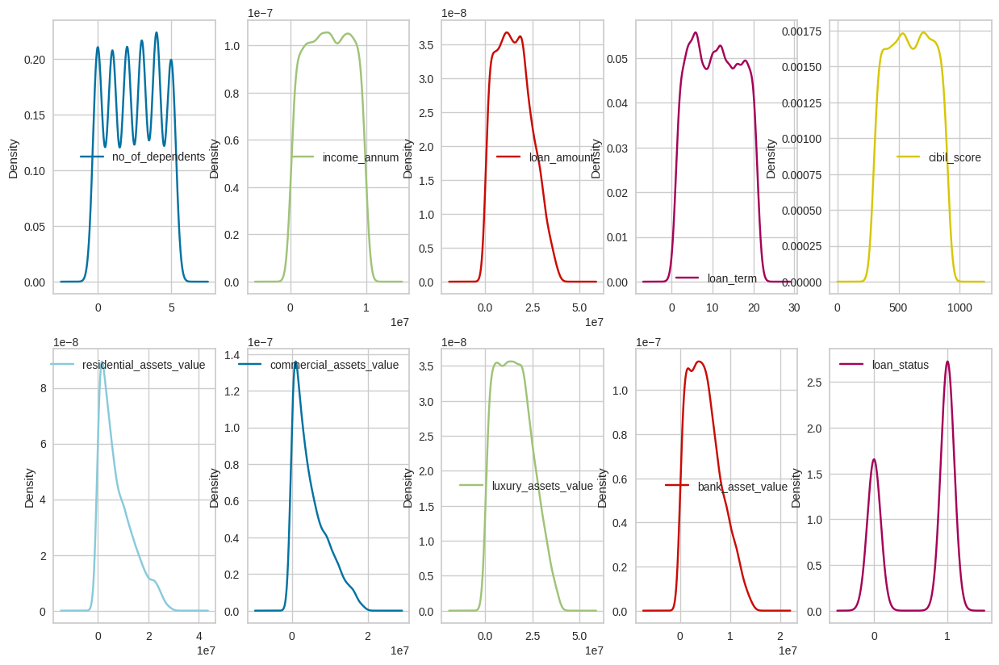

In [12]:
df.plot(kind='density', subplots=True, layout=(3,5), sharex=False,figsize=(15,15))

In [13]:
df.skew()

no_of_dependents           -0.017971
income_annum               -0.012814
loan_amount                 0.308724
loan_term                   0.036359
cibil_score                -0.009039
residential_assets_value    0.978451
commercial_assets_value     0.957791
luxury_assets_value         0.322208
bank_asset_value            0.560725
loan_status                -0.504087
dtype: float64

Using Box Plot to find the outliers in the data

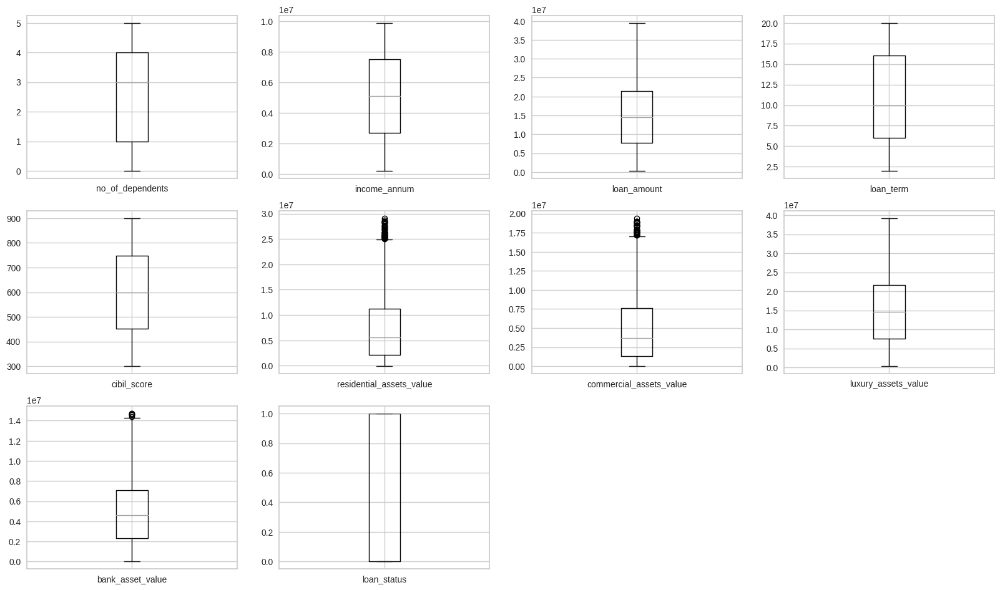

In [14]:
plt.figure(figsize=(20,40))
i=1
for col in df.columns:
    plt.subplot(10,4,i)
    df[[col]].boxplot()
    i+=1

array([[<Axes: title={'center': 'no_of_dependents'}>,
        <Axes: title={'center': 'income_annum'}>,
        <Axes: title={'center': 'loan_amount'}>],
       [<Axes: title={'center': 'loan_term'}>,
        <Axes: title={'center': 'cibil_score'}>,
        <Axes: title={'center': 'residential_assets_value'}>],
       [<Axes: title={'center': 'commercial_assets_value'}>,
        <Axes: title={'center': 'luxury_assets_value'}>,
        <Axes: title={'center': 'bank_asset_value'}>],
       [<Axes: title={'center': 'loan_status'}>, <Axes: >, <Axes: >]],
      dtype=object)

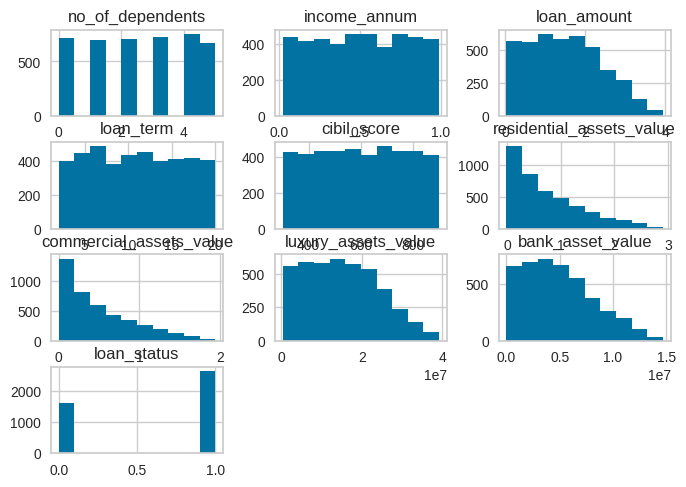

In [15]:
df.hist()

***Drawing QQ plots to determine the normally distributed columns***

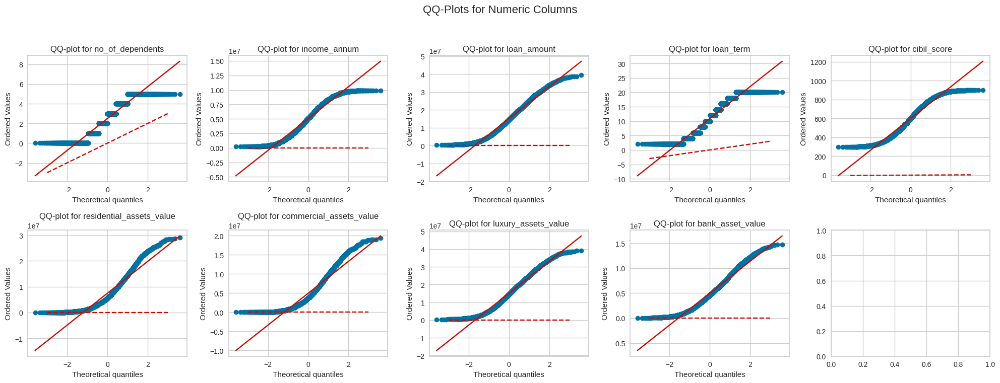

In [16]:


# Select columns for QQ-plots
numeric_columns = [ 'no_of_dependents', 'income_annum', 'loan_amount', 'loan_term', 'cibil_score',
                    'residential_assets_value', 'commercial_assets_value', 'luxury_assets_value', 'bank_asset_value']

# Create a figure with subplots
fig, axs = plt.subplots(2, 5, figsize=(20, 8))
fig.suptitle('QQ-Plots for Numeric Columns', fontsize=16)

# Flatten the axs array for easier indexing
axs = axs.flatten()

# Plot QQ-plots for each numeric column
for i, column in enumerate(numeric_columns):
    stats.probplot(df[column], plot=axs[i])
    axs[i].set_title(f'QQ-plot for {column}')
    axs[i].plot([-3, 3], [-3, 3], color='r', linestyle='--')

# Adjust layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

# Show the plots
plt.show()


***removing outliers using the upper and lower whiskers of the box plot***

In [17]:

# the columns we want to remove outliers
columns_to_remove_outliers = ['residential_assets_value', 'commercial_assets_value', 'bank_asset_value']

# Replace outliers with the mean of the column
def replace_outliers_with_mean(df, columns):
    for column in columns:
        # Calculate the IQR (Interquartile Range)
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1

        # Define whisker boundaries
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Replace outliers with the mean of the column
        df[column] = np.where((df[column] < lower_bound) | (df[column] > upper_bound), df[column].mean(), df[column])

        df[column] = df[column].astype(np.int64)

    return df

# Replace outliers with the mean of the column
df_no_outliers_mean = replace_outliers_with_mean(df, columns_to_remove_outliers)


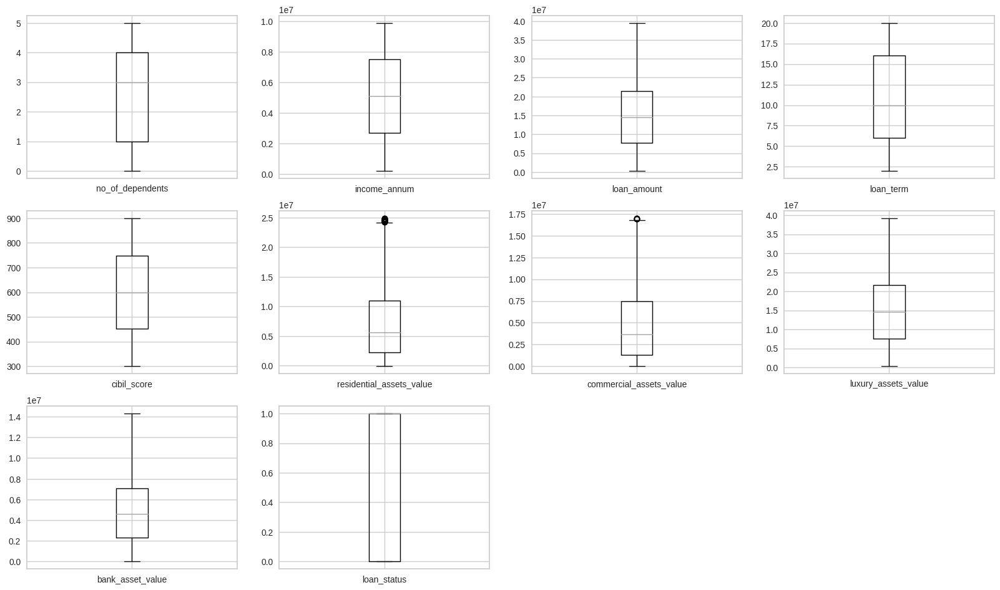

In [18]:
plt.figure(figsize=(20,40))
i=1
for col in df.columns:
    plt.subplot(10,4,i)
    df[[col]].boxplot()
    i+=1

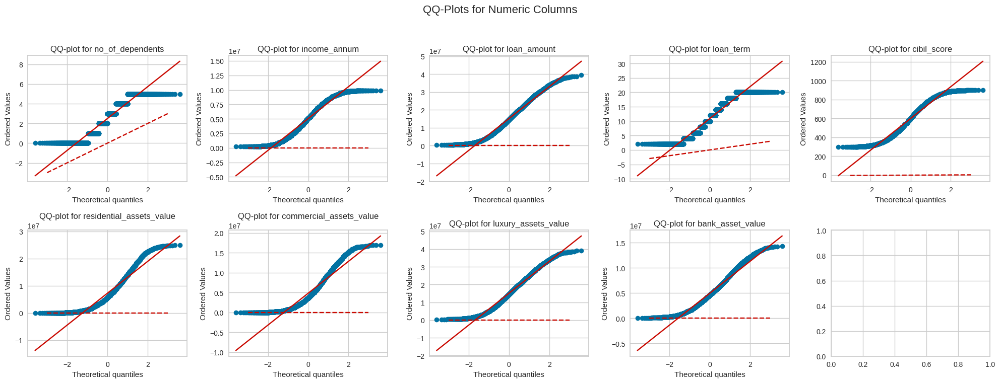

In [19]:
# Select columns for QQ-plots
numeric_columns = [ 'no_of_dependents', 'income_annum', 'loan_amount', 'loan_term', 'cibil_score',
                    'residential_assets_value', 'commercial_assets_value', 'luxury_assets_value', 'bank_asset_value']

# Create a figure with subplots
fig, axs = plt.subplots(2, 5, figsize=(20, 8))
fig.suptitle('QQ-Plots for Numeric Columns', fontsize=16)

# Flatten the axs array for easier indexing
axs = axs.flatten()

# Plot QQ-plots for each column
for i, column in enumerate(numeric_columns):
    stats.probplot(df[column], plot=axs[i])
    axs[i].set_title(f'QQ-plot for {column}')
    axs[i].plot([-3, 3], [-3, 3], color='r', linestyle='--')

# Adjust layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

# Show the plots
plt.show()

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   no_of_dependents          4269 non-null   int64
 1   income_annum              4269 non-null   int64
 2   loan_amount               4269 non-null   int64
 3   loan_term                 4269 non-null   int64
 4   cibil_score               4269 non-null   int64
 5   residential_assets_value  4269 non-null   int64
 6   commercial_assets_value   4269 non-null   int64
 7   luxury_assets_value       4269 non-null   int64
 8   bank_asset_value          4269 non-null   int64
 9   loan_status               4269 non-null   int64
dtypes: int64(10)
memory usage: 333.6 KB


***Normalizing the data using min max normalization***

In [21]:
# Normalize using min max normalization
df1_normalize = df.drop('loan_status', axis=1)
def normalize(data: pd.Series) -> pd.Series:
    return (data - np.min(data)) / (np.max(data) - np.min(data))

# Normalize the columns
df1_normalize['no_of_dependents'] = normalize(df1_normalize[['no_of_dependents']])
df1_normalize['income_annum'] = normalize(df1_normalize[['income_annum']])
df1_normalize['loan_amount'] = normalize(df1_normalize[['loan_amount']])
df1_normalize['cibil_score'] = normalize(df1_normalize[['cibil_score']])
df1_normalize['loan_term'] = normalize(df1_normalize[['loan_term']])
df1_normalize['residential_assets_value'] = normalize(df1_normalize[['residential_assets_value']])
df1_normalize['commercial_assets_value'] = normalize(df1_normalize[['commercial_assets_value']])
df1_normalize['luxury_assets_value'] = normalize(df1_normalize[['luxury_assets_value']])
df1_normalize['bank_asset_value'] = normalize(df1_normalize[['bank_asset_value']])


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:84: FutureWarning: In a future version, DataFrame.min(axis=None) will return a scalar min over the entire DataFrame. To retain the old behavior, use 'frame.min(axis=0)' or just 'frame.min()'
  return reduction(axis=axis, out=out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:84: FutureWarning: In a future version, DataFrame.max(axis=None) will return a scalar max over the entire DataFrame. To retain the old behavior, use 'frame.max(axis=0)' or just 'frame.max()'
  return reduction(axis=axis, out=out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:84: FutureWarning: In a future version, DataFrame.min(axis=None) will return a scalar min over the entire DataFrame. To retain the old behavior, use 'frame.min(axis=0)' or just 'frame.min()'
  return reduction(axis=axis, out=out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:84: 

In [22]:
# from yellowbrick.cluster import SilhouetteVisualizer
# # df1_normalize=df1_normalize.drop('Cluster',axis=1)

# X = df1_normalize

# fig, ax = plt.subplots(2, 2, figsize=(15, 8))

# for i in range(2, 6):
#     # Create KMeans instance for different numbers of clusters
#     km = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)

#     # Calculate the subplot position
#     q, mod = divmod(i, 2)

#     # Create SilhouetteVisualizer instance with KMeans instance
#     visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])

#     # Fit the visualizer
#     visualizer.fit(X)

# plt.show()

# ***Training the model before applying clustering and PCA***

In [23]:
# import matplotlib.pyplot as plt
# import numpy as np
# from sklearn.datasets import make_classification
# from sklearn.linear_model import LogisticRegression

# # Generate synthetic data
# X = df1_normalize[['cibil_score', 'no_of_dependents']]
# y = df['loan_status']

# # Train a logistic regression model
# model = LogisticRegression()
# model.fit(X, y)

# # Plot decision boundary and data points
# plt.scatter(X['cibil_score'], X['no_of_dependents'], c=y, cmap='viridis', edgecolors='k', marker='o', s=100)
# ax = plt.gca()
# xlim = ax.get_xlim()
# ylim = ax.get_ylim()

# # Create grid to evaluate model
# xx, yy = np.meshgrid(np.linspace(xlim[0], xlim[1], 100), np.linspace(ylim[0], ylim[1], 100))
# Z = model.predict(np.c_[xx.ravel(), yy.ravel()])

# # Plot decision boundary
# Z = Z.reshape(xx.shape)
# plt.contour(xx, yy, Z, colors='k', levels=[0.5], linestyles=['-'])

# plt.xlabel('Cibil Score')
# plt.ylabel('Number of Dependents')
# plt.title('Decision Boundary and Data Points')
# plt.show()


 Logistic Regression Accuracy: 0.9121779859484778
Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.87      0.88       318
           1       0.93      0.93      0.93       536

    accuracy                           0.91       854
   macro avg       0.91      0.90      0.91       854
weighted avg       0.91      0.91      0.91       854



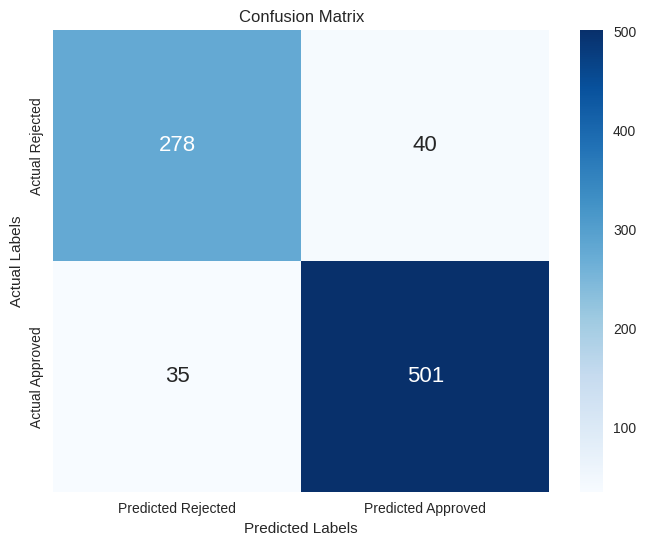

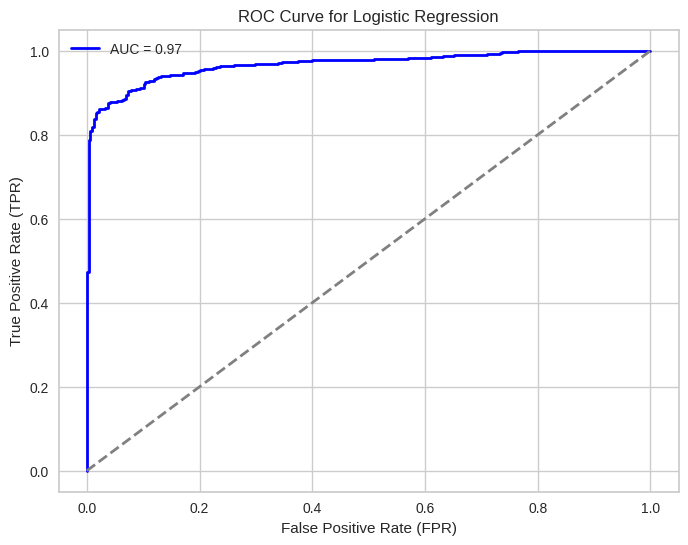

AUC: 0.97


In [24]:

X = df1_normalize

Y = df['loan_status']

# Train-test split (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Create and train a Logistic Regression model
log_model = LogisticRegression(random_state=42, multi_class='ovr', max_iter=1000)
log_model.fit(X_train, Y_train)

# Predictions of the model
log_predictions = log_model.predict(X_test)


accuracy = accuracy_score(Y_test, log_predictions)
classification_rep = classification_report(Y_test, log_predictions)

print(f" Logistic Regression Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)




conf_mat = confusion_matrix(Y_test, log_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])


plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = log_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Logistic Regression')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')



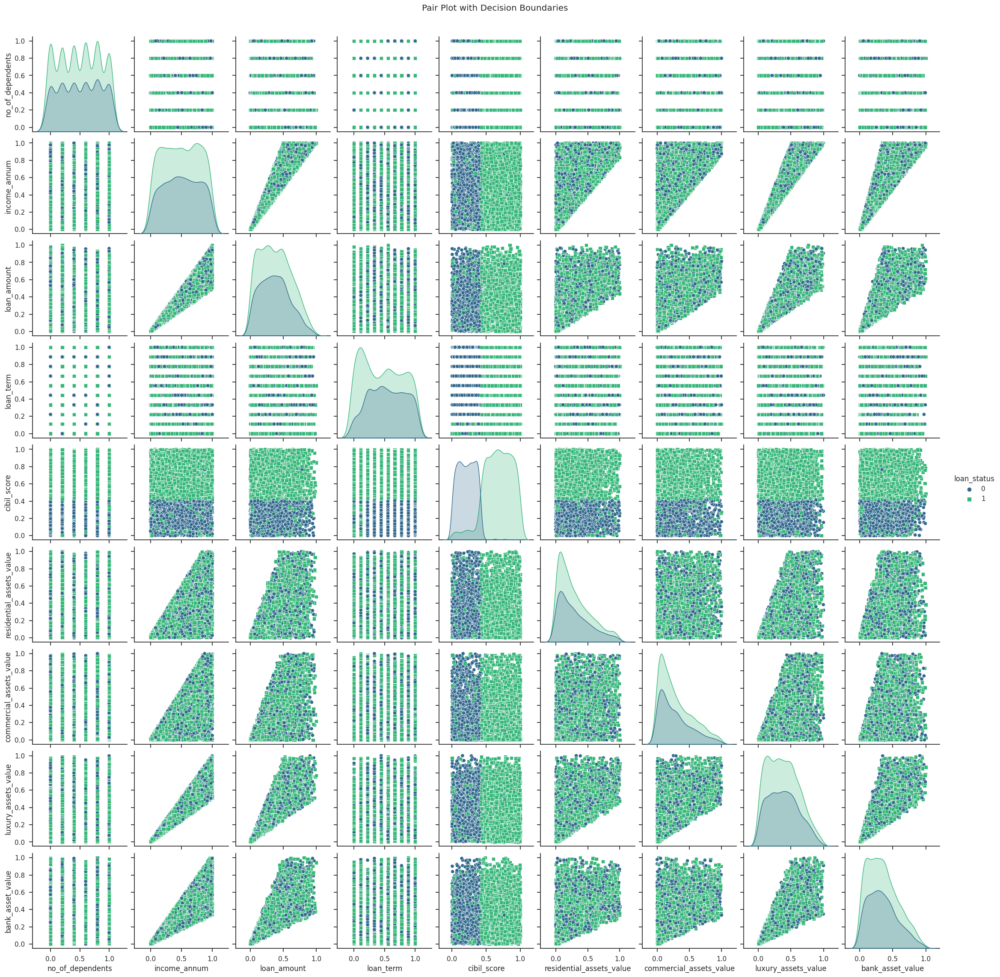

In [25]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

Random Forest Accuracy: 0.977751756440281
Random Forest Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.96      0.97       318
           1       0.98      0.99      0.98       536

    accuracy                           0.98       854
   macro avg       0.98      0.97      0.98       854
weighted avg       0.98      0.98      0.98       854



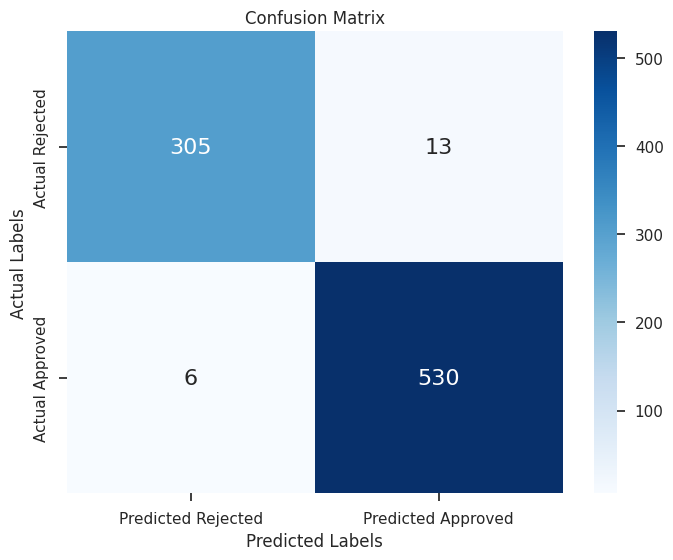

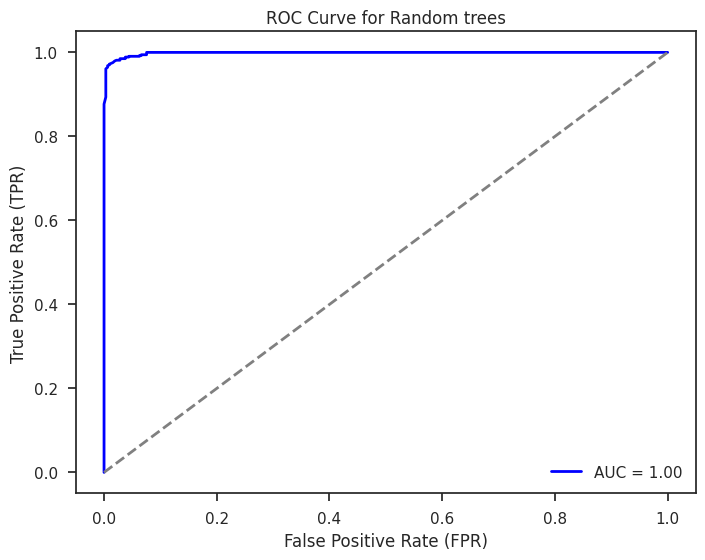

AUC: 1.00


In [26]:
from sklearn.ensemble import RandomForestClassifier

X = df1_normalize

Y = df['loan_status']

# Train-test split (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Random Forest Classifier
rf_model = RandomForestClassifier(random_state=42, n_estimators=100)
rf_model.fit(X_train, Y_train)

# Predictions
rf_predictions = rf_model.predict(X_test)

# Evaluation
accuracy_rf = accuracy_score(Y_test, rf_predictions)
classification_rep_rf = classification_report(Y_test, rf_predictions)

print(f"Random Forest Accuracy: {accuracy_rf}")
print("Random Forest Classification Report:\n", classification_rep_rf)

conf_mat = confusion_matrix(Y_test, rf_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])

plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = rf_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Random trees')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')


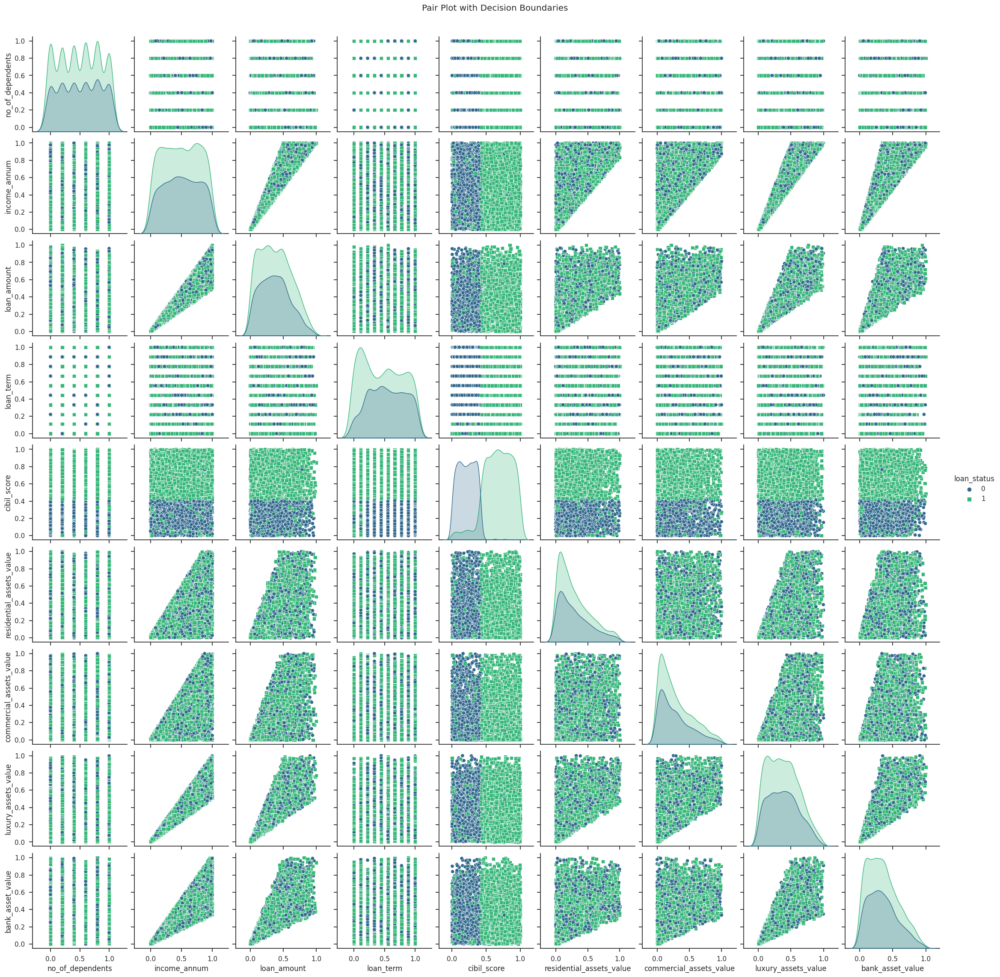

In [27]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

Naive Bayes Accuracy: 0.9391100702576113
Naive Bayes Classification Report:
               precision    recall  f1-score   support

           0       0.90      0.94      0.92       318
           1       0.97      0.94      0.95       536

    accuracy                           0.94       854
   macro avg       0.93      0.94      0.94       854
weighted avg       0.94      0.94      0.94       854



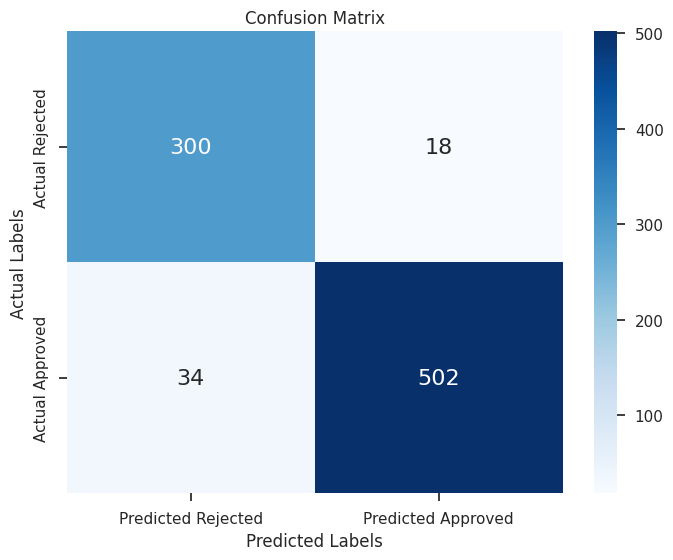

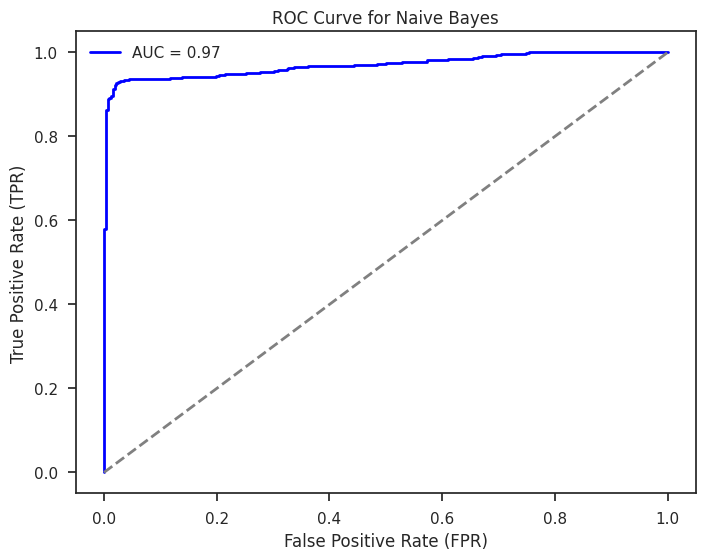

AUC: 0.97


In [28]:

X = df1_normalize

Y = df['loan_status']

# Train-test split (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Gaussian Naive Bayes
nb_model = GaussianNB()
nb_model.fit(X_train, Y_train)

# Predictions
nb_predictions = nb_model.predict(X_test)

# Evaluation
accuracy_nb = accuracy_score(Y_test, nb_predictions)
classification_rep_nb = classification_report(Y_test, nb_predictions)

print(f"Naive Bayes Accuracy: {accuracy_nb}")
print("Naive Bayes Classification Report:\n", classification_rep_nb)

conf_mat = confusion_matrix(Y_test, nb_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])
plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = nb_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Naive Bayes')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')


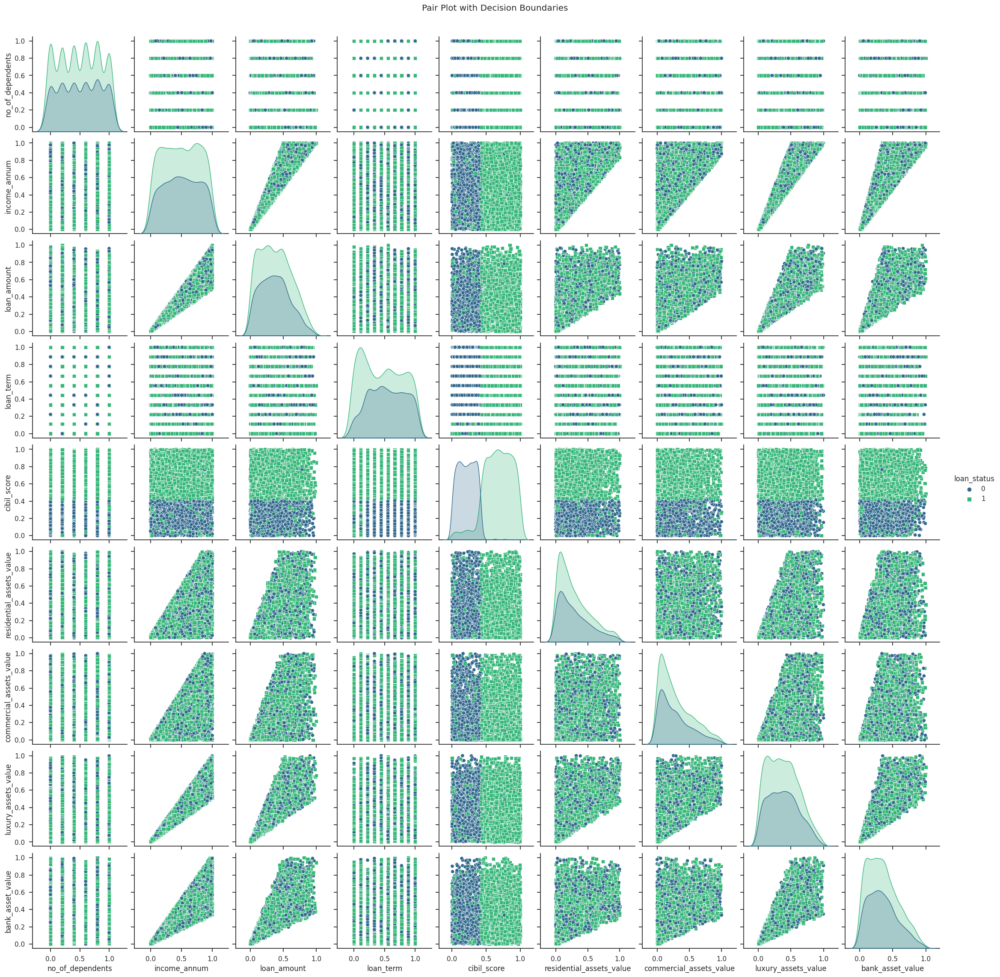

In [29]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

# ***PCA analysis***

***Displaying the variance of each column descendingly***

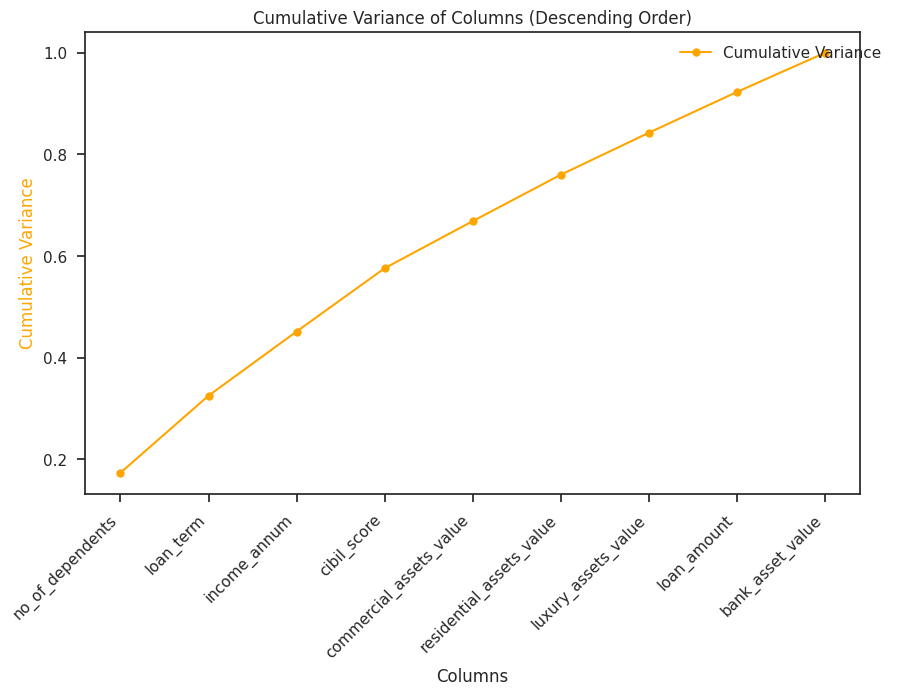

In [30]:
# Assuming df1_normalize is your DataFrame

# Calculate the variances for each column
variances = df1_normalize.var()

# Sort the variances in descending order
sorted_variances = variances.sort_values(ascending=False)

# Calculate cumulative variance
cumulative_variance = sorted_variances.cumsum() / sorted_variances.sum()

# Create a figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Plot cumulative variance as a line chart
ax.plot(sorted_variances.index, cumulative_variance, color='orange', marker='o', label='Cumulative Variance')

# Set labels and title
ax.set_xlabel('Columns')
ax.set_ylabel('Cumulative Variance', color='orange')
ax.set_title('Cumulative Variance of Columns (Descending Order)')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Show legend
ax.legend(loc='upper left', bbox_to_anchor=(0.75, 1))

# Show the plot
plt.show()

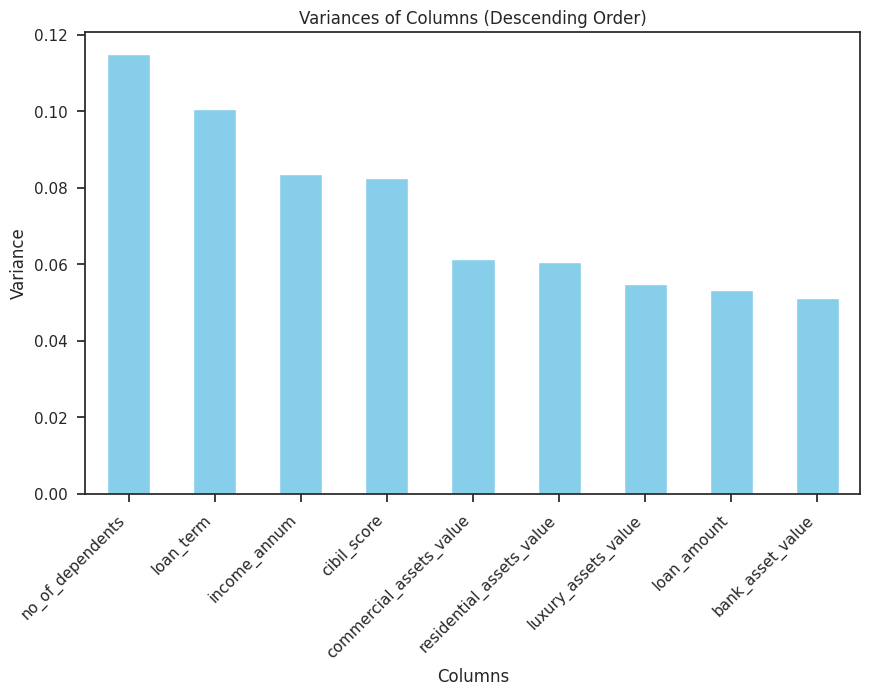

In [31]:

# Calculate the variances for each column
variances = df1_normalize.var()

# Sort the variances in descending order
sorted_variances = variances.sort_values(ascending=False)

# Create a bar plot
plt.figure(figsize=(10, 6))
sorted_variances.plot(kind='bar', color='skyblue')
plt.title('Variances of Columns (Descending Order)')
plt.xlabel('Columns')
plt.ylabel('Variance')
plt.xticks(rotation=45, ha='right')
plt.show()


In [32]:
selected_columns = ['no_of_dependents', 'loan_term', 'income_annum', 'cibil_score']
data_subset = df1_normalize[selected_columns]

pca = PCA(n_components=4)

pca_result = pca.fit_transform(data_subset)

df1_pca = pd.DataFrame(data=pca_result, columns=[f'PC{i+1}' for i in range(pca_result.shape[1])])


# Print the number of components and the total explained variance
print("Number of Components:", pca.n_components_)

Number of Components: 4


In [33]:

#parallel coordinates plot
fig = px.parallel_coordinates(df1_pca, color='class_labels' if 'class_labels' in df1_pca else None)
fig.show()


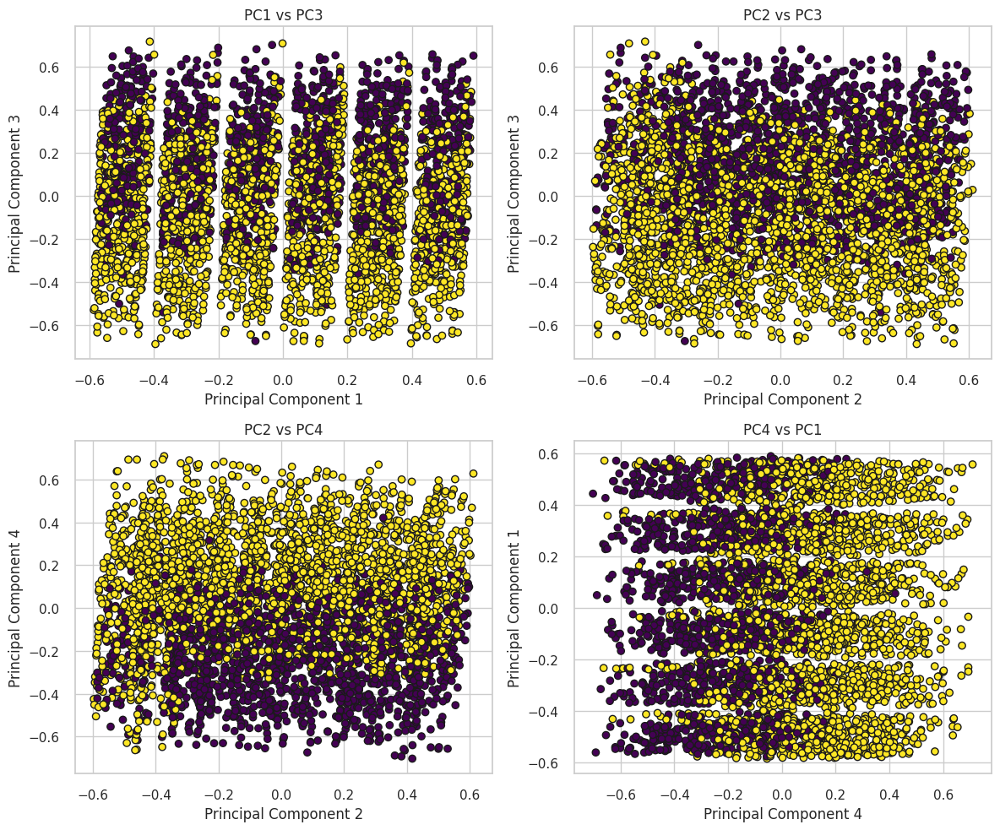

In [34]:
sns.set(style="whitegrid")
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Scatter plot for PC1 and PC3
axes[0, 0].scatter(df1_pca['PC1'], df1_pca['PC3'], c=df['loan_status'], cmap='viridis', edgecolor='k', marker='o')
axes[0, 0].set_xlabel('Principal Component 1')
axes[0, 0].set_ylabel('Principal Component 3')
axes[0, 0].set_title('PC1 vs PC3')

# Scatter plot for PC2 and PC3
axes[0, 1].scatter(df1_pca['PC2'], df1_pca['PC3'], c=df['loan_status'], cmap='viridis', edgecolor='k', marker='o')
axes[0, 1].set_xlabel('Principal Component 2')
axes[0, 1].set_ylabel('Principal Component 3')
axes[0, 1].set_title('PC2 vs PC3')

# Scatter plot for PC3 and PC4
axes[1, 0].scatter(df1_pca['PC2'], df1_pca['PC4'], c=df['loan_status'], cmap='viridis', edgecolor='k', marker='o')
axes[1, 0].set_xlabel('Principal Component 2')
axes[1, 0].set_ylabel('Principal Component 4')
axes[1, 0].set_title('PC2 vs PC4')

# Scatter plot for PC4 and PC1
axes[1, 1].scatter(df1_pca['PC4'], df1_pca['PC1'], c=df['loan_status'], cmap='viridis', edgecolor='k', marker='o')
axes[1, 1].set_xlabel('Principal Component 4')
axes[1, 1].set_ylabel('Principal Component 1')
axes[1, 1].set_title('PC4 vs PC1')

# Adjust layout to prevent clipping of titles
plt.tight_layout()
plt.show()



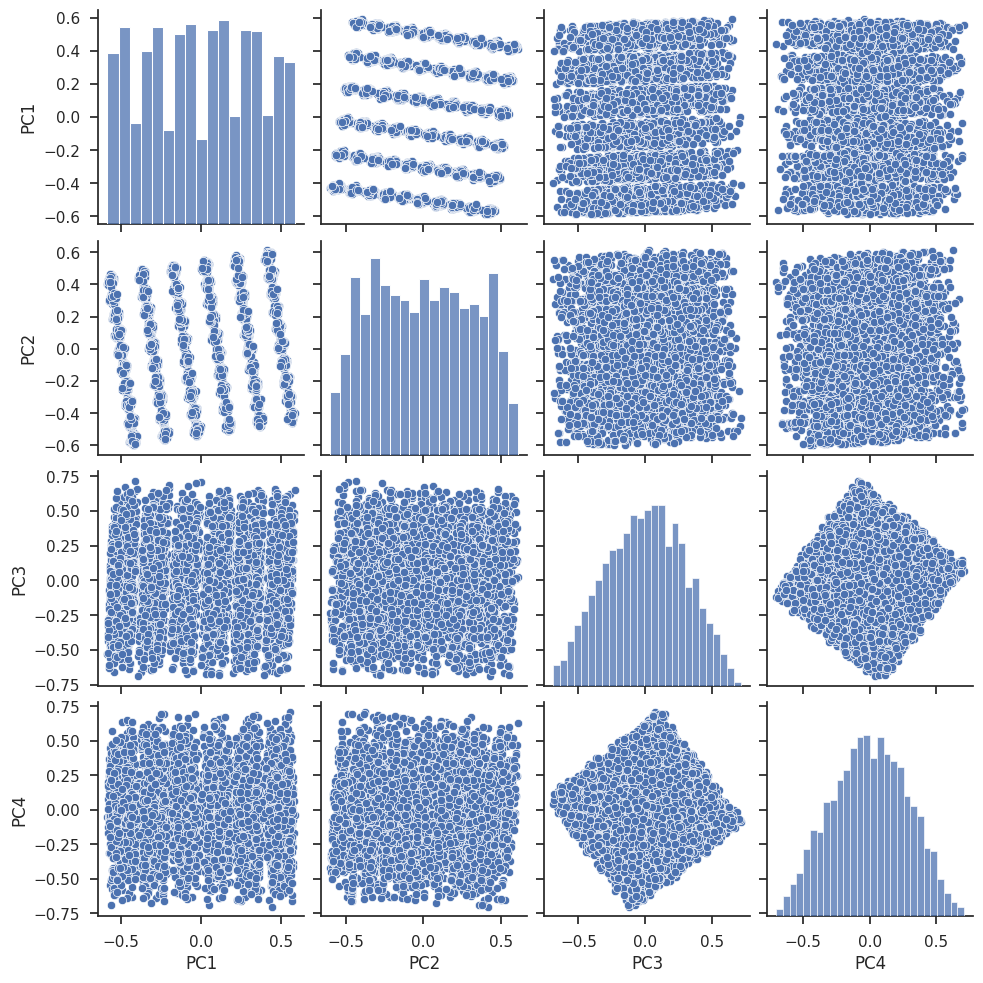

In [35]:
selected_columns = ['PC1', 'PC2', 'PC3', 'PC4']
data_subset = df1_pca[selected_columns]
# Create a pair plot
sns.set(style="ticks")
sns.pairplot(data_subset)

# Show the plot
plt.show()

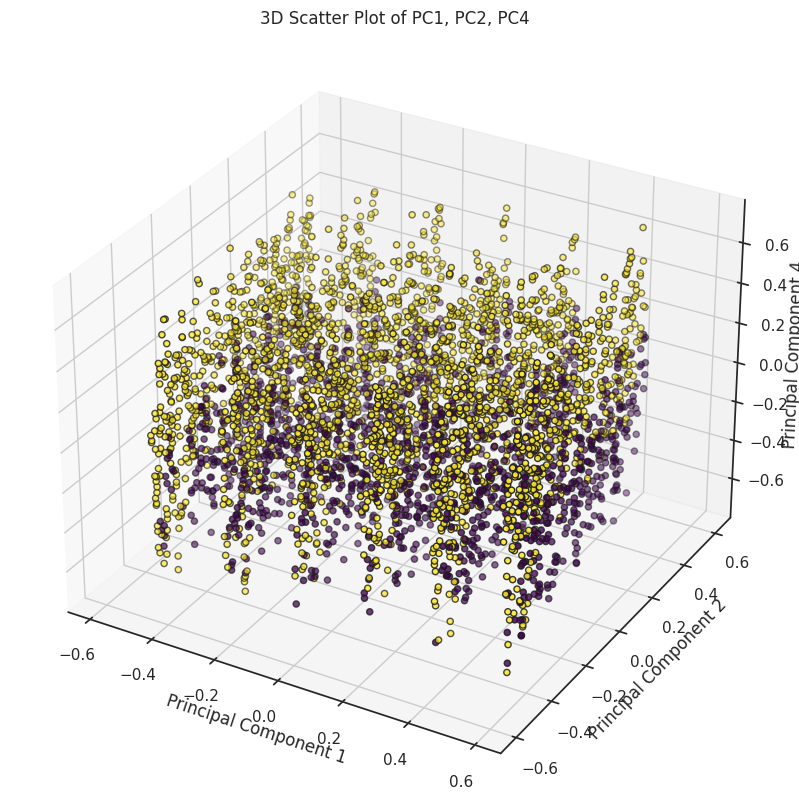

In [36]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot for PC1, PC2, PC4
ax.scatter(df1_pca['PC1'], df1_pca['PC2'], df1_pca['PC4'], c=df['loan_status'], cmap='viridis', edgecolor='k', marker='o')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 4')
ax.set_title('3D Scatter Plot of PC1, PC2, PC4')

plt.show()

# **KMeans Clustering**

***Using elbow method to determine optimal number of clusters***

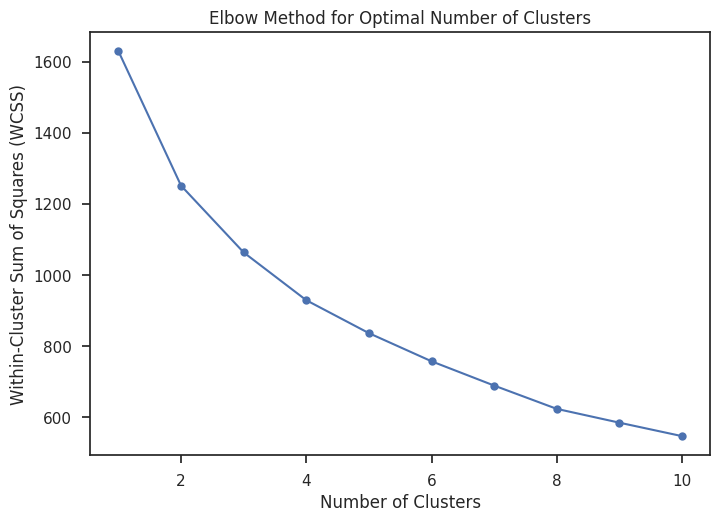

In [37]:
# Within-cluster sum of squares
wcss = []

for i in range(1, 11):  # Trying different numbers of clusters
    kmeans = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    kmeans.fit(df1_pca)
    wcss.append(kmeans.inertia_)

# Plot the elbow method
plt.plot(range(1, 11), wcss, marker='o')
plt.title('Elbow Method for Optimal Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.show()

***Silhouette graph to determine number of clusters***

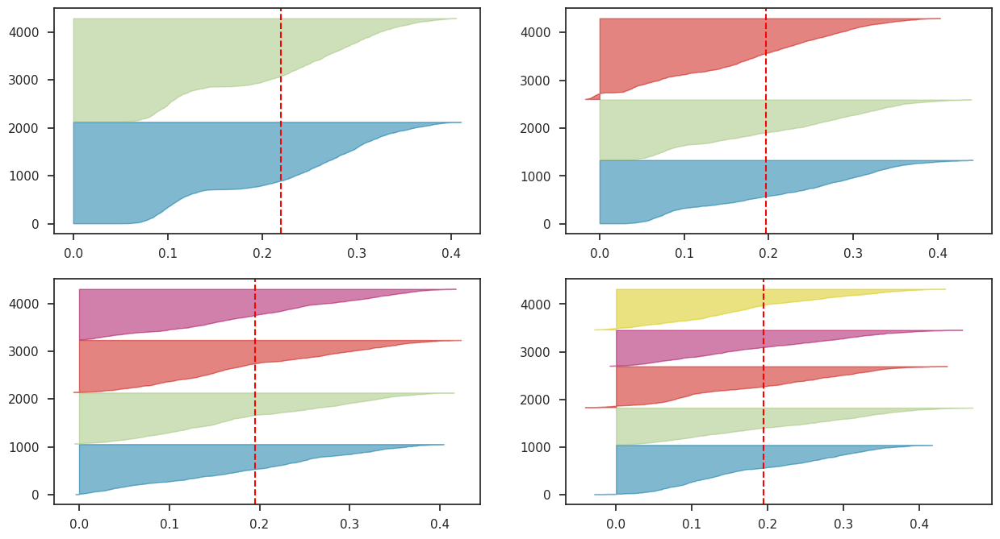

In [38]:
from yellowbrick.cluster import SilhouetteVisualizer

X = df1_pca

fig, ax = plt.subplots(2, 2, figsize=(15, 8))

for i in range(2, 6):
    # Create KMeans for different numbers of clusters
    km = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)

    # Calculate the subplot position
    q, mod = divmod(i, 2)

    # Create SilhouetteVisualizer instance with KMeans instance
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])

    visualizer.fit(X)

plt.show()

In [39]:
df1_pca.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   PC1     4269 non-null   float64
 1   PC2     4269 non-null   float64
 2   PC3     4269 non-null   float64
 3   PC4     4269 non-null   float64
dtypes: float64(4)
memory usage: 133.5 KB


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



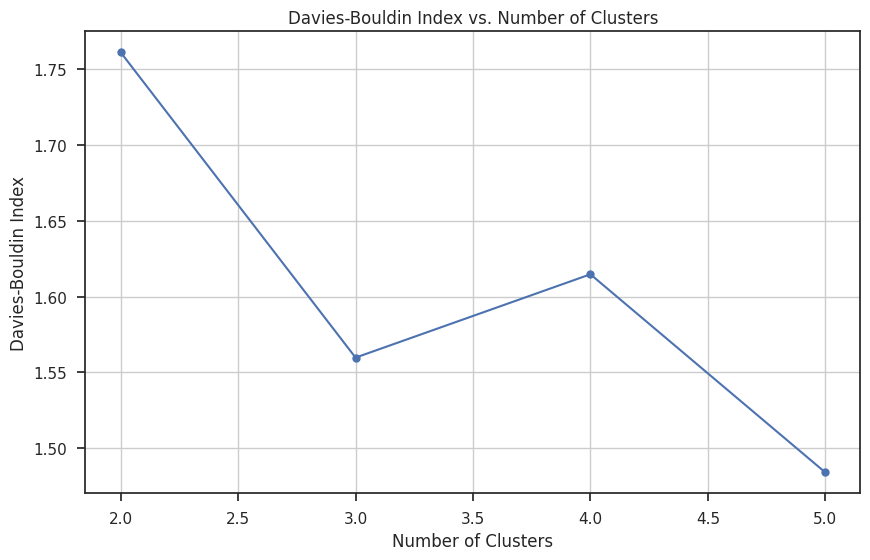

In [40]:
# Create the Davies-Bouldin Index for range 2 to 5
def calculate_davies_bouldin_scores_kmeans(data, max_clusters=10):
    davies_bouldin_scores = []
    for n_clusters in range(2, max_clusters + 1):
        kmeans = KMeans(n_clusters=n_clusters, random_state=0)
        labels = kmeans.fit_predict(data)
        davies_bouldin_scores.append(davies_bouldin_score(data, labels))
    return davies_bouldin_scores

max_clusters = 5
davies_bouldin_scores = calculate_davies_bouldin_scores_kmeans(X, max_clusters)

# Plot the Davies-Bouldin Index
plt.figure(figsize=(10, 6))
plt.plot(range(2, max_clusters + 1), davies_bouldin_scores, marker='o', linestyle='-', color='b')
plt.title('Davies-Bouldin Index vs. Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Index')
plt.grid(True)
plt.show()

***Creating and Visualizing the Kmeans clustering***

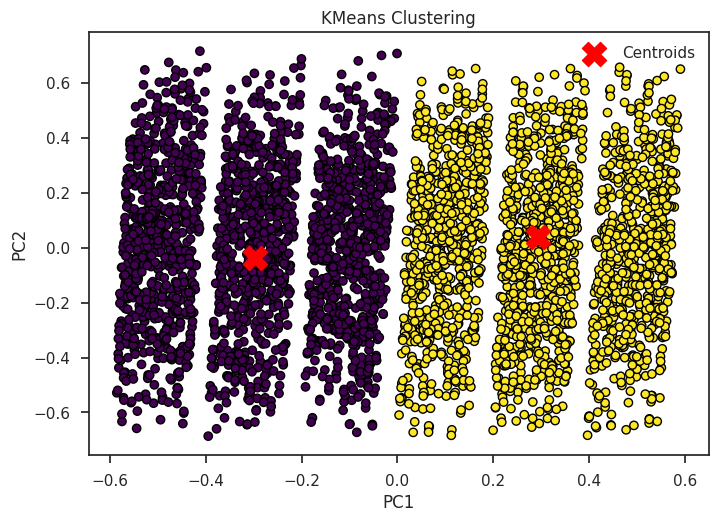

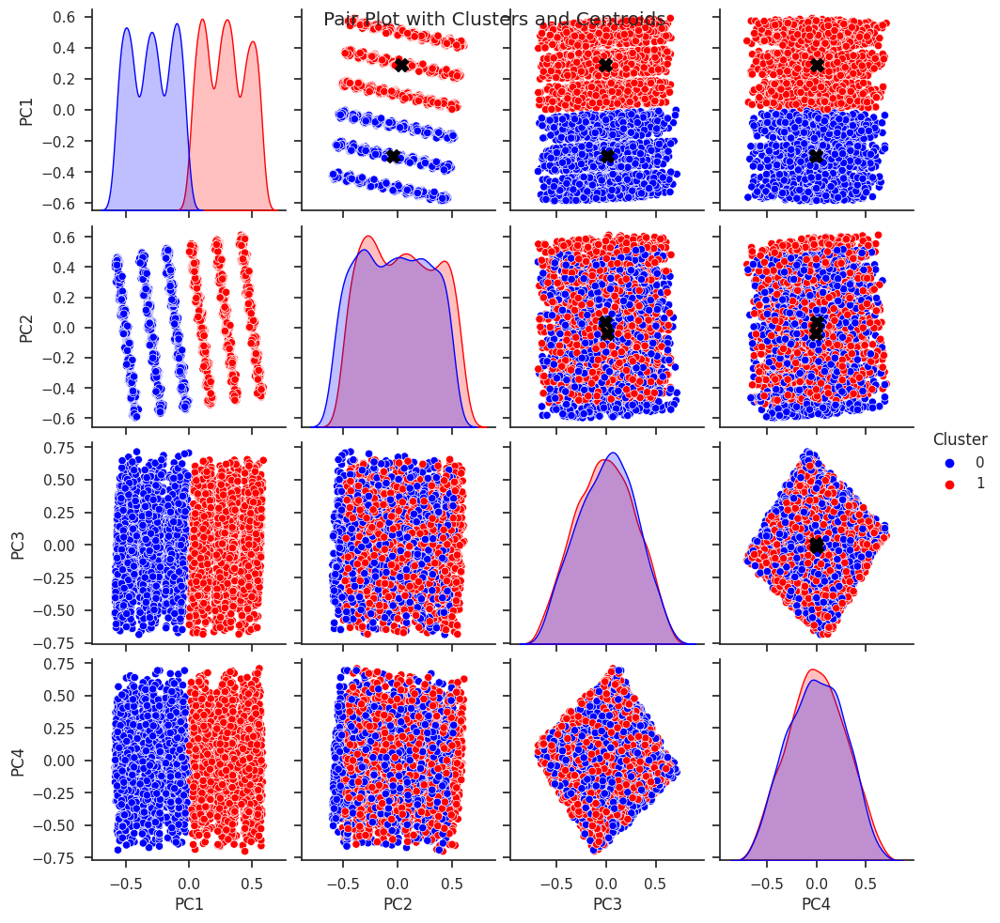

In [41]:

X = df1_pca

# Choosing the number of clusters
num_clusters = 2

# Initialize KMeans
kmeans = KMeans(n_clusters=num_clusters, init='k-means++', max_iter=300, n_init=10, random_state=0)


# Fit and predict clusters
kmeans.fit(X)
df1_pca['Cluster'] = kmeans.labels_

# # Visualize the clusters (for 2D data, such as principal components)
plt.scatter(X['PC1'], X['PC3'], c=df1_pca['Cluster'], cmap='viridis', marker='o', edgecolor='black')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='red', marker='X', label='Centroids')
plt.title('KMeans Clustering')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

# Create a pair plot for all principal components
selected_columns = ['PC1', 'PC2', 'PC3', 'PC4']
pairplot_data = X[selected_columns].copy()
pairplot_data['Cluster'] = df1_pca['Cluster']

custom_palette = sns.color_palette(['blue', 'red'], n_colors=len(pairplot_data['Cluster'].unique()))

sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='Cluster', palette=custom_palette, markers='o', diag_kind='kde')

# Plot centroids on each subplot
for i, j in zip(*np.triu_indices_from(g.axes, 1)):
    g.axes[i, j].scatter(kmeans.cluster_centers_[:, j], kmeans.cluster_centers_[:, i], s=100, c='black', marker='X', label='Centroids')

plt.suptitle('Pair Plot with Clusters and Centroids')
plt.show()



In [42]:

X=X.drop('Cluster',axis=1)
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   PC1     4269 non-null   float64
 1   PC2     4269 non-null   float64
 2   PC3     4269 non-null   float64
 3   PC4     4269 non-null   float64
dtypes: float64(4)
memory usage: 133.5 KB


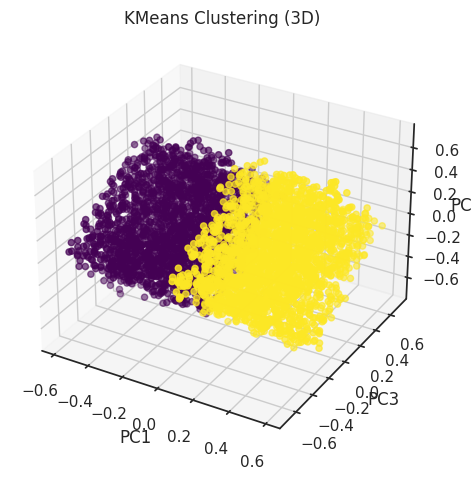

In [43]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Assuming kmeans is your fitted KMeans model and df1_pca is a DataFrame with columns 'PC1', 'PC2', 'PC3', 'PC4'
cluster_assignments = kmeans.predict(X)

ax.scatter(X['PC1'], X['PC3'], X['PC4'], c=cluster_assignments, cmap='viridis')
ax.set_title('KMeans Clustering (3D)')
ax.set_xlabel('PC1')
ax.set_ylabel('PC3')
ax.set_zlabel('PC4')
plt.show()


In [44]:
# def euclidean(x, y):
#     return np.sqrt(np.sum(np.square(x - y)))

# def inter_cluster(x, y):
#     inter = np.ones([len(x), len(y)])
#     for a in range(len(x)):
#         for b in range(len(y)):
#             inter[a, b] = euclidean(x[a], y[b])
#     return np.min(inter)

# def intra_cluster(x):
#     intra = np.zeros([len(x), len(x)])
#     for a in range(len(x)):
#         for b in range(len(x)):
#             intra[a, b] = euclidean(x[a], x[b])
#     return np.max(intra)

# def dunn(_list_):
#     inter = np.ones([len(_list_), len(_list_)])
#     intra = np.zeros([len(_list_), 1])
#     clus_range = list(range(len(_list_)))
#     for a in clus_range:
#         for b in (clus_range[0:a] + clus_range[a+1:]):
#             inter[a, b] = inter_cluster(_list_[a], _list_[b])
#             intra[a] = intra_cluster(_list_[a])
#     return np.min(inter) / np.max(intra)

# def calculate_dunn_scores(data, max_clusters=10):
#     dunn_scores = []
#     for n_clusters in range(2, max_clusters + 1):
#         cluster_list = np.array_split(data.values, n_clusters)  # Convert to numpy array
#         dunn_scores.append(dunn(cluster_list))
#     return dunn_scores

# # Assuming df1_pca is your feature matrix
# # Adjust df1_pca based on your specific dataset
# X = df1_pca[['PC1', 'PC2', 'PC3', 'PC4']]

# max_clusters = 6
# dunn_scores = calculate_dunn_scores(X, max_clusters)

# # Plot the Dunn Index
# plt.figure(figsize=(10, 6))
# plt.plot(range(2, max_clusters + 1), dunn_scores, marker='o', linestyle='-', color='b')
# plt.title('Dunn Index vs. Number of Clusters')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Dunn Index')
# plt.grid(True)
# plt.show()

***Training the data after Kmeans clustering and doing PCA***


Accuracy: 0.9133489461358314
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.88      0.88       318
           1       0.93      0.93      0.93       536

    accuracy                           0.91       854
   macro avg       0.91      0.91      0.91       854
weighted avg       0.91      0.91      0.91       854



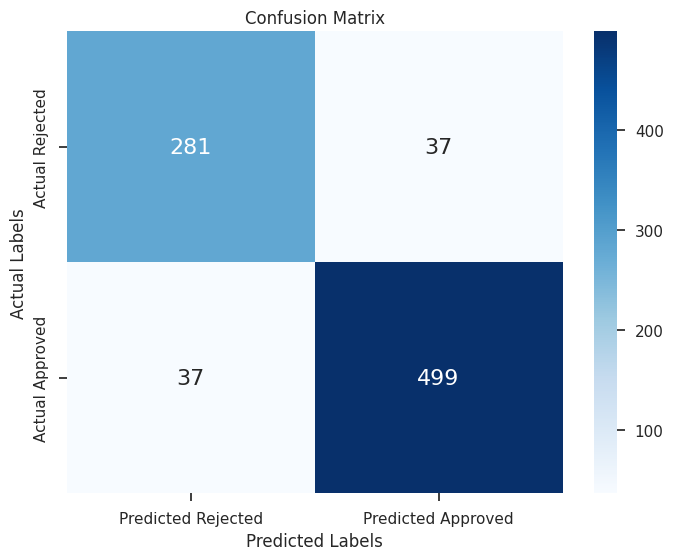

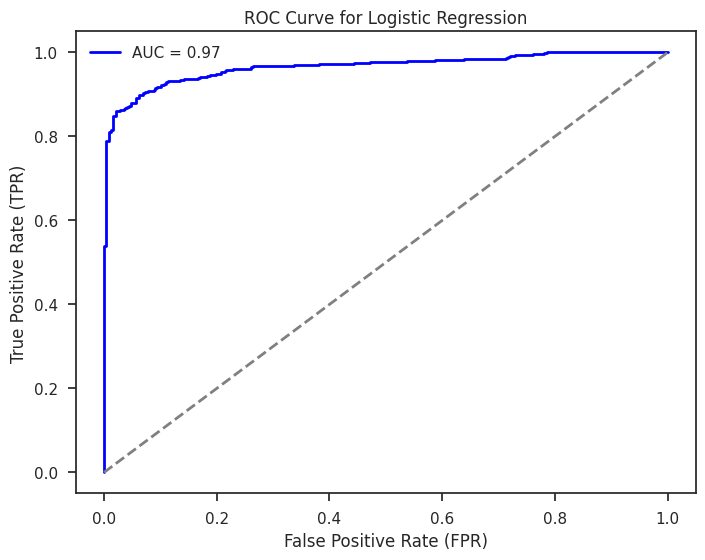

AUC: 0.97


In [45]:
# Prepare the data
X = df1_pca
Y = df['loan_status']

# Split the data into training and testing sets (80:20)

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Create and train a Logistic Regression model
log_model = LogisticRegression(random_state=42, multi_class='ovr', max_iter=1000)
log_model.fit(X_train, Y_train)

# Make predictions on the test set
log_predictions = log_model.predict(X_test)


accuracy = accuracy_score(Y_test, log_predictions)
classification_rep = classification_report(Y_test, log_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)




conf_mat = confusion_matrix(Y_test, log_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])


plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = log_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Logistic Regression')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')


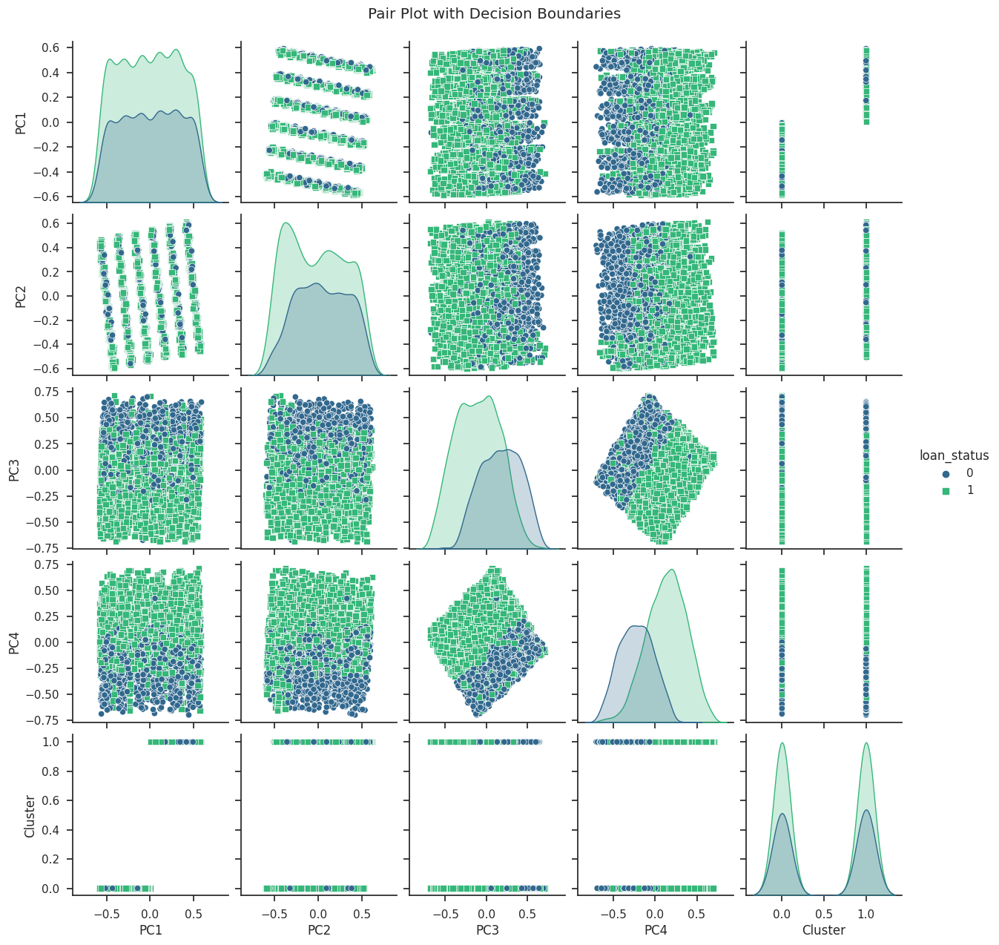

In [46]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Accuracy: 0.6276346604215457
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       318
           1       0.63      1.00      0.77       536

    accuracy                           0.63       854
   macro avg       0.31      0.50      0.39       854
weighted avg       0.39      0.63      0.48       854



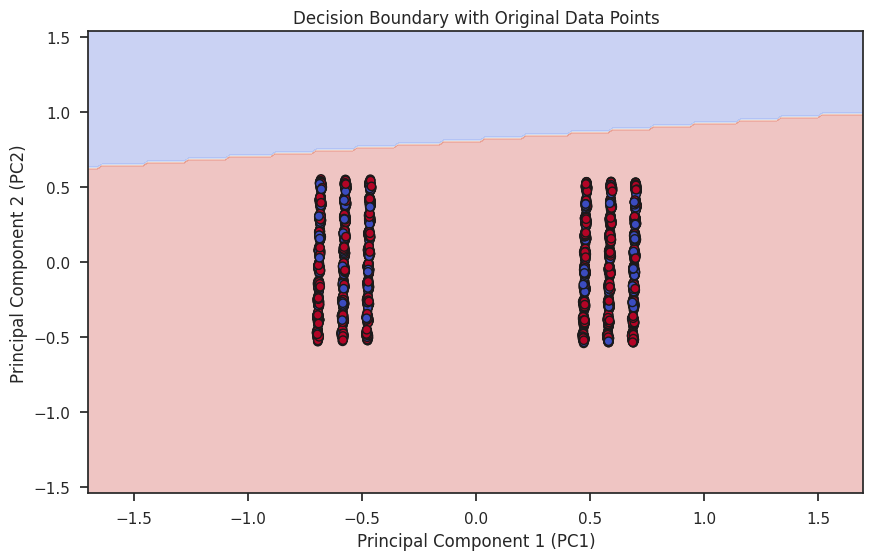

In [47]:
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

# Create and train a Logistic Regression model
log_model = LogisticRegression(random_state=42, multi_class='ovr', max_iter=1000)
log_model.fit(X_train, Y_train)

# Make predictions on the test set
log_predictions = log_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, log_predictions)
classification_rep = classification_report(Y_test, log_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot the decision boundary
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = log_model.predict(np.c_[xx.ravel(), yy.ravel()])


Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Boundary with Original Data Points')
plt.show()

Random Forest Accuracy: 0.9414519906323185
Random Forest Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.92      0.92       318
           1       0.96      0.95      0.95       536

    accuracy                           0.94       854
   macro avg       0.94      0.94      0.94       854
weighted avg       0.94      0.94      0.94       854



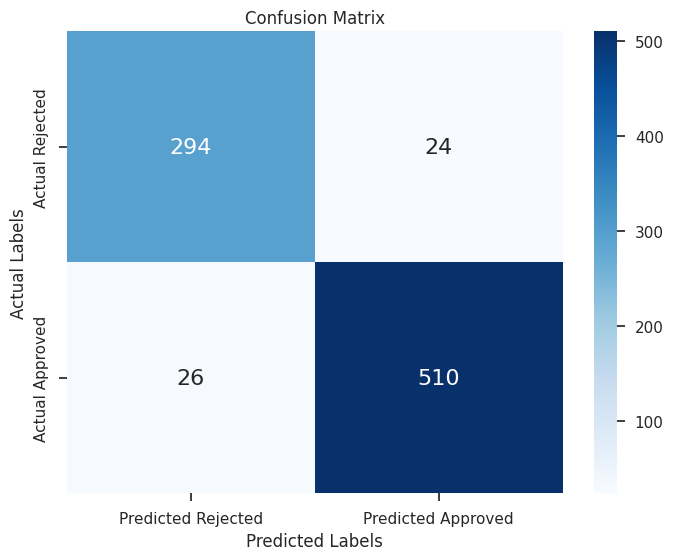

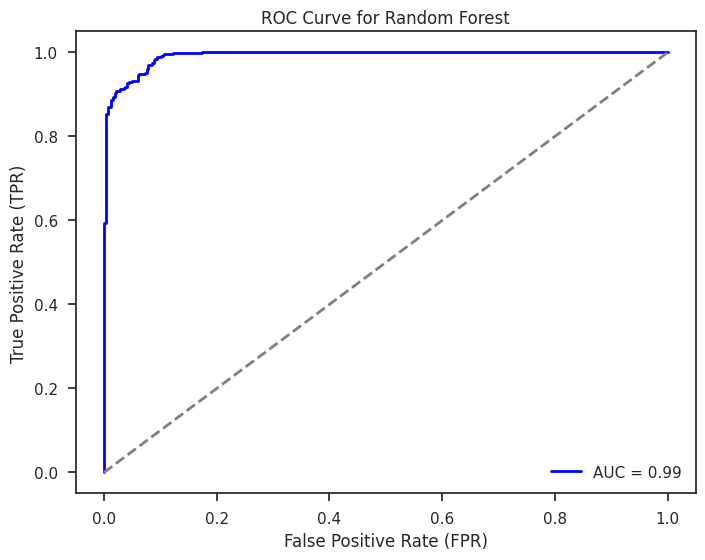

AUC: 0.99


In [48]:
from sklearn.ensemble import RandomForestClassifier

X = df1_pca

Y = df['loan_status']

# Train-test split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Random Forest Classifier
n_estimators = 100
max_depth = 10
min_samples_split = 5
# Create the RandomForestClassifier with the specified hyperparameters
rf_model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
rf_model.fit(X_train, Y_train)

# Predictions
rf_predictions = rf_model.predict(X_test)

# Evaluation
accuracy_rf = accuracy_score(Y_test, rf_predictions)
classification_rep_rf = classification_report(Y_test, rf_predictions)

print(f"Random Forest Accuracy: {accuracy_rf}")
print("Random Forest Classification Report:\n", classification_rep_rf)

conf_mat = confusion_matrix(Y_test, rf_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])

plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

rf_probs = rf_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, rf_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, rf_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Random Forest')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')



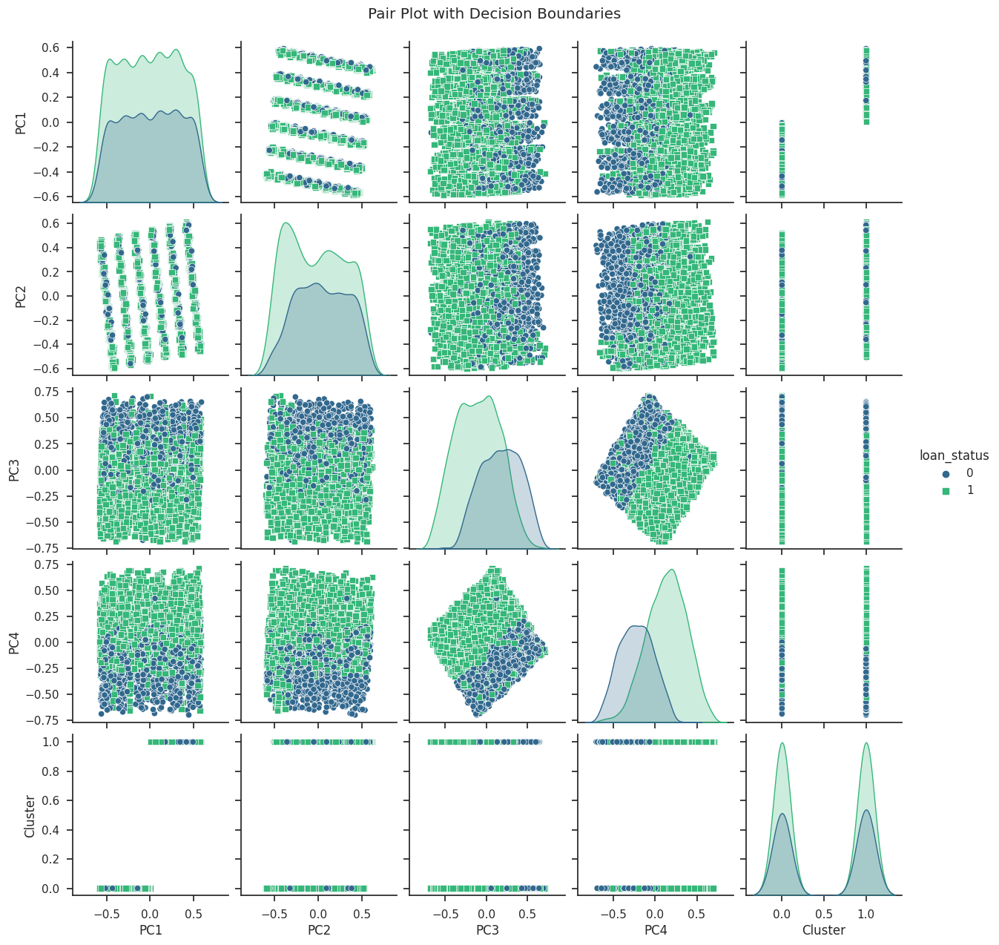

In [49]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

Accuracy: 0.7704918032786885
Classification Report:
               precision    recall  f1-score   support

           0       0.90      0.43      0.58       318
           1       0.74      0.97      0.84       536

    accuracy                           0.77       854
   macro avg       0.82      0.70      0.71       854
weighted avg       0.80      0.77      0.75       854



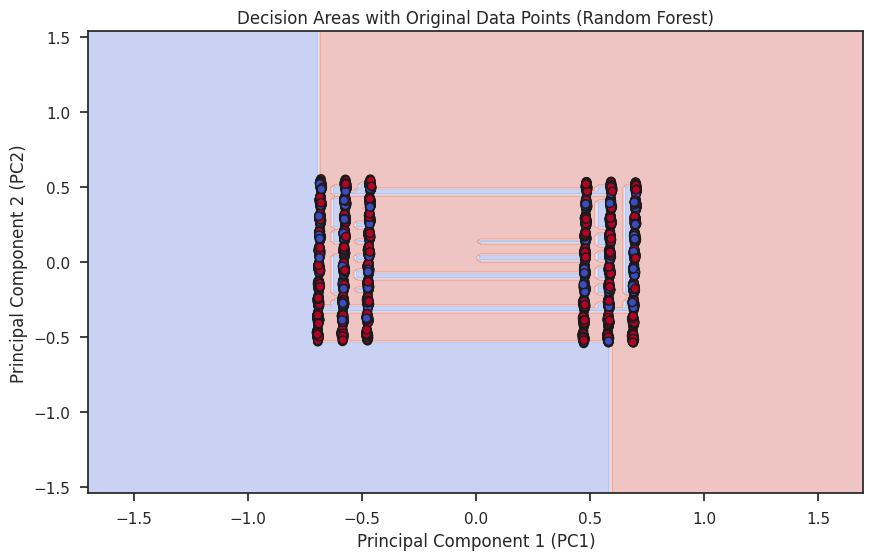

In [50]:
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

n_estimators = 100
max_depth = 10
min_samples_split = 5
# Create the RandomForestClassifier with the specified hyperparameters
rf_model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
rf_model.fit(X_train, Y_train)
rf_model.fit(X_train, Y_train)

# Make predictions on the test set
rf_predictions = rf_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, rf_predictions)
classification_rep = classification_report(Y_test, rf_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot decision areas
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = rf_model.predict(np.c_[xx.ravel(), yy.ravel()])


Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Areas with Original Data Points (Random Forest)')
plt.show()

Naive Bayes Accuracy: 0.9156908665105387
Naive Bayes Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.89      0.89       318
           1       0.94      0.93      0.93       536

    accuracy                           0.92       854
   macro avg       0.91      0.91      0.91       854
weighted avg       0.92      0.92      0.92       854



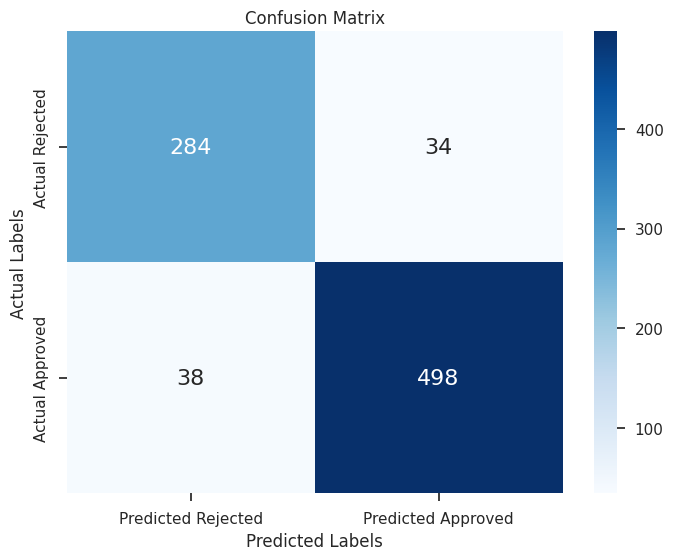

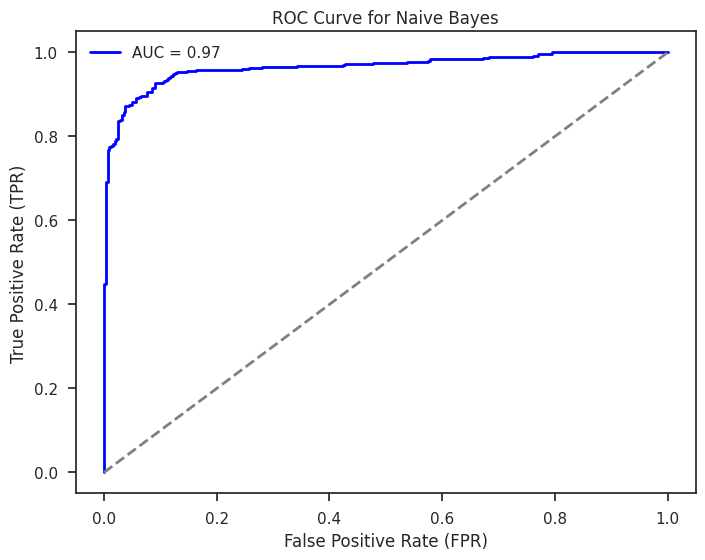

AUC: 0.97


In [51]:

X = df1_pca

Y = df['loan_status']

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Gaussian Naive Bayes
best_params = {'var_smoothing': 1e-09}
nb_model = GaussianNB(**best_params)
nb_model.fit(X_train, Y_train)

# Predictions
nb_predictions = nb_model.predict(X_test)

# Evaluation
accuracy_nb = accuracy_score(Y_test, nb_predictions)
classification_rep_nb = classification_report(Y_test, nb_predictions)

print(f"Naive Bayes Accuracy: {accuracy_nb}")
print("Naive Bayes Classification Report:\n", classification_rep_nb)

conf_mat = confusion_matrix(Y_test, nb_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])
plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = nb_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Naive Bayes')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')


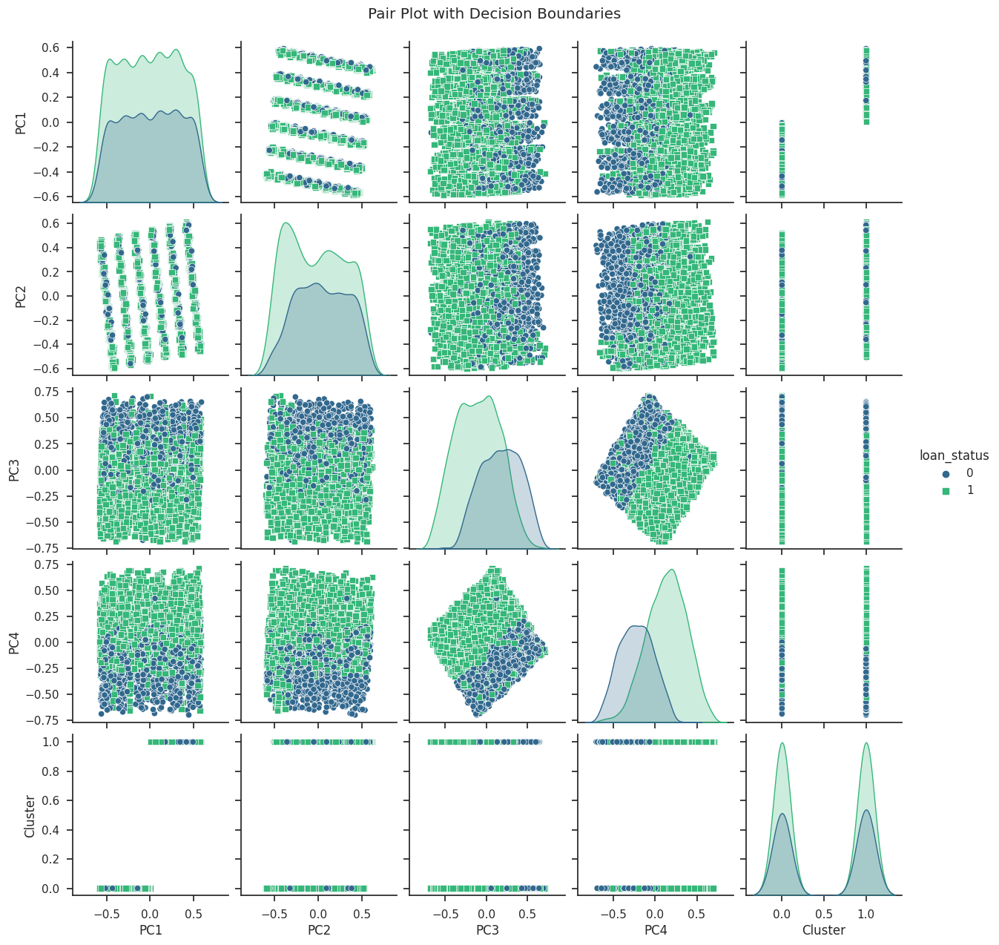

In [52]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Accuracy: 0.6276346604215457
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       318
           1       0.63      1.00      0.77       536

    accuracy                           0.63       854
   macro avg       0.31      0.50      0.39       854
weighted avg       0.39      0.63      0.48       854



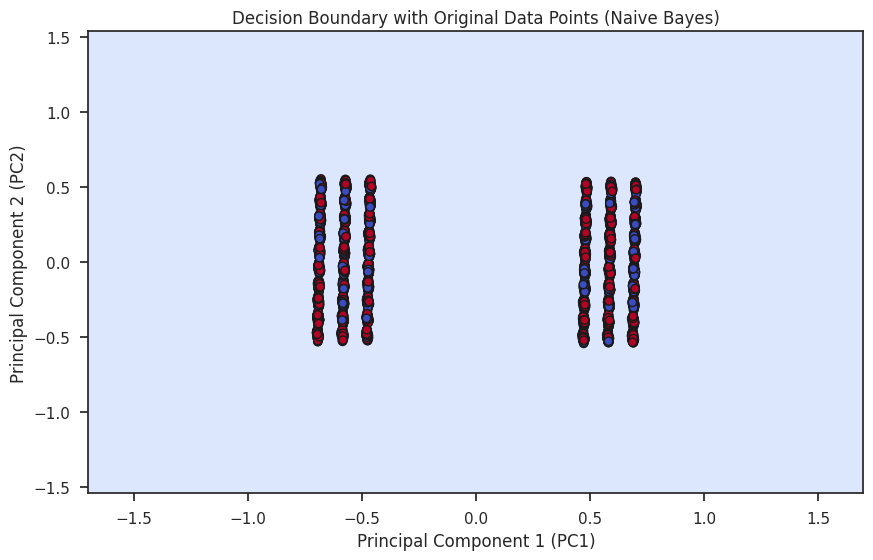

In [53]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report

# Assuming df1_pca and df are defined

# Extract features and target variable
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

# Create and train a Gaussian Naive Bayes model
nb_model = GaussianNB()
nb_model.fit(X_train, Y_train)

# Make predictions on the test set
nb_predictions = nb_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, nb_predictions)
classification_rep = classification_report(Y_test, nb_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot the decision boundary
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = nb_model.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Boundary with Original Data Points (Naive Bayes)')
plt.show()

# ***Creating hierarchical clustering using Agglomerative clustering***

In [54]:
df1_pca = df1_pca.drop('Cluster', axis=1)

In [55]:
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)

model = model.fit(df1_pca)

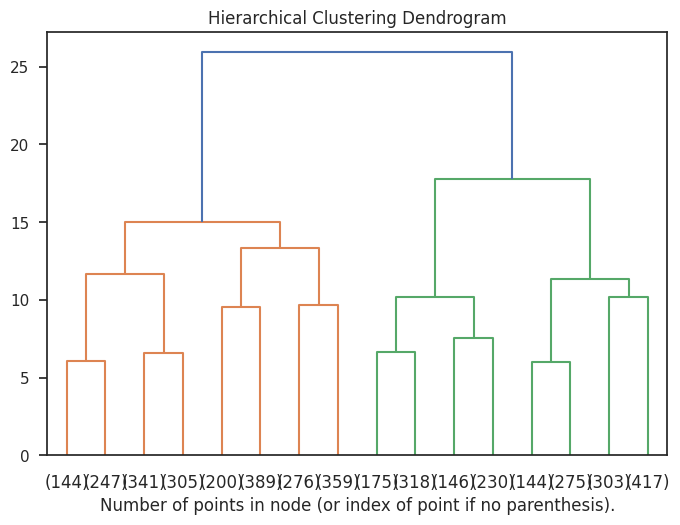

In [56]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)


plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

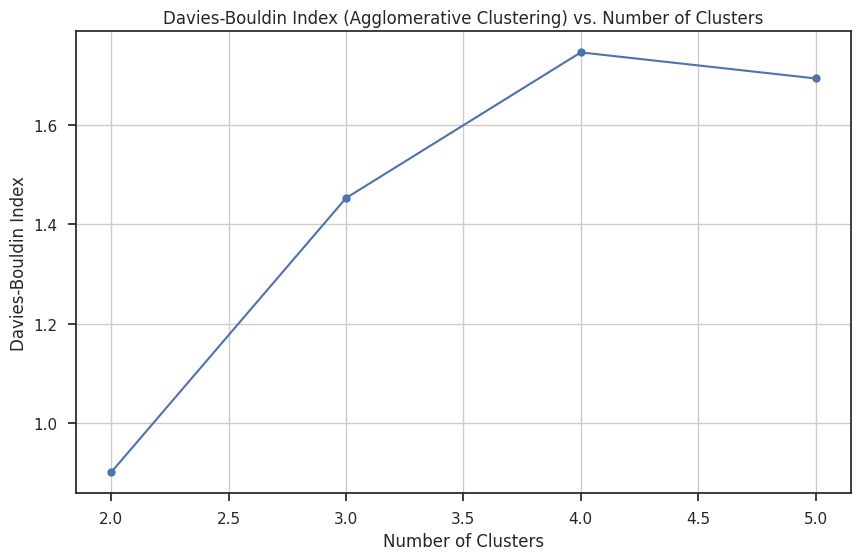

In [57]:
# create the Davies-Bouldin Index for Agglomerative Clustering range from 2 to 5
def calculate_davies_bouldin_scores_Agglomerative(data, max_clusters=10):
    davies_bouldin_scores = []
    for n_clusters in range(2, max_clusters + 1):
        agg_clustering = AgglomerativeClustering(n_clusters=n_clusters)
        labels = agg_clustering.fit_predict(data)
        davies_bouldin_scores.append(davies_bouldin_score(data, labels))
    return davies_bouldin_scores

max_clusters = 5
davies_bouldin_scores_agg = calculate_davies_bouldin_scores_Agglomerative(X, max_clusters)

# Plot the Davies-Bouldin Index for Agglomerative Clustering
plt.figure(figsize=(10, 6))
plt.plot(range(2, max_clusters + 1), davies_bouldin_scores_agg, marker='o', linestyle='-', color='b')
plt.title('Davies-Bouldin Index (Agglomerative Clustering) vs. Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Index')
plt.grid(True)
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning:

Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead



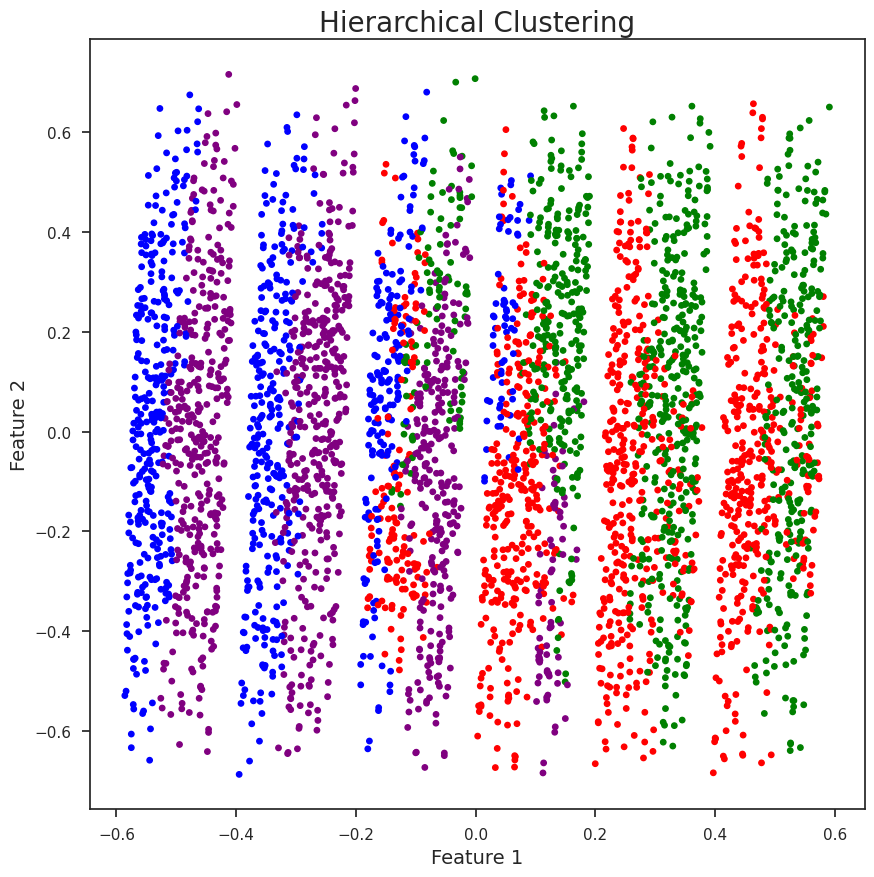

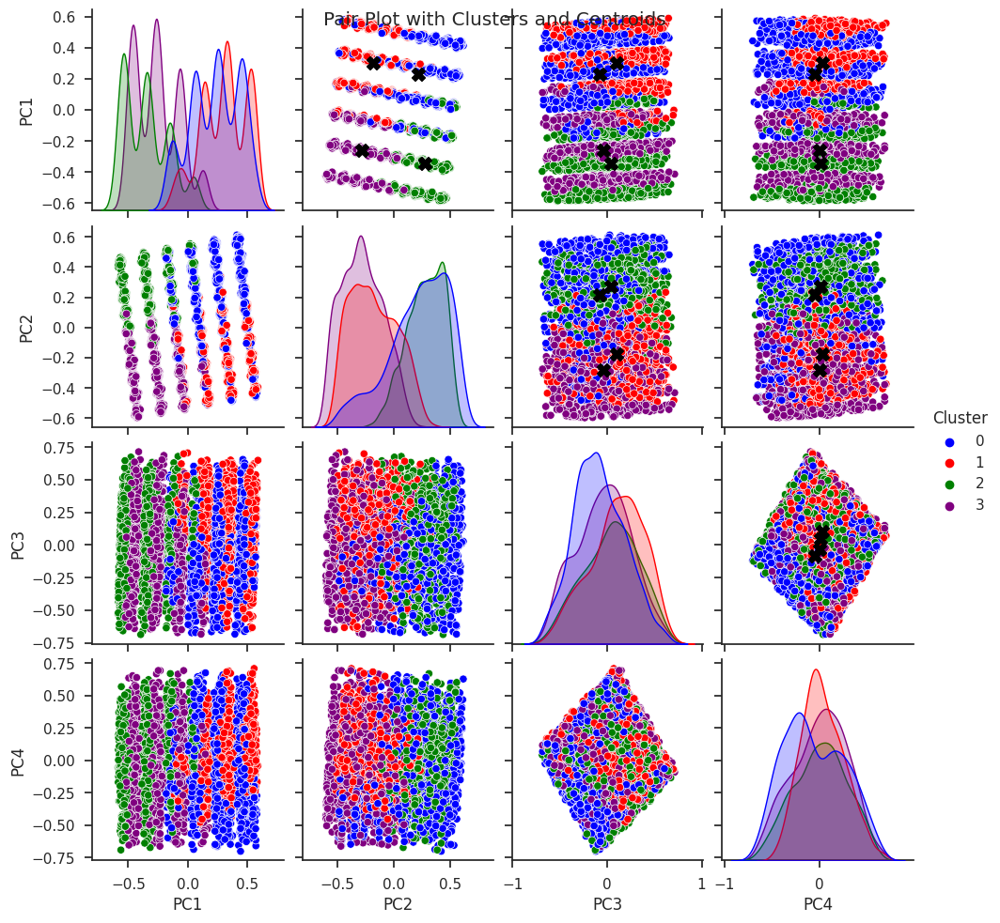

In [58]:


colors = ['red', 'green', 'blue', 'purple']
custom_cmap = matplotlib.colors.ListedColormap(colors)


X = df1_pca[['PC1', 'PC2', 'PC3', 'PC4']]

# Initialize Agglomerative Clustering
model = AgglomerativeClustering(n_clusters=4, affinity='euclidean')

# Fit the model to the data
model.fit(X)

# Add cluster labels to the original DataFrame
df1_pca['Cluster'] = model.labels_

# Visualize the clustering results using a custom colormap
plt.figure(figsize=(10, 10))
plt.scatter(X['PC1'], X['PC3'], c=df1_pca['Cluster'], cmap=custom_cmap, s=15)
plt.title('Hierarchical Clustering', fontsize=20)
plt.xlabel('Feature 1', fontsize=14)
plt.ylabel('Feature 2', fontsize=14)
plt.show()

# Create a pair plot for all principal components
selected_columns = ['PC1', 'PC2', 'PC3', 'PC4']
pairplot_data = X[selected_columns].copy()
pairplot_data['Cluster'] = df1_pca['Cluster']


custom_palette = sns.color_palette(['blue', 'red', 'green', 'purple'], n_colors=len(pairplot_data['Cluster'].unique()))


sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='Cluster', palette=custom_palette, markers='o', diag_kind='kde')

# Plot centroids for each cluster on each subplot
centroids = kmeans.cluster_centers_
unique_cluster_ids = pairplot_data['Cluster'].unique()
for cluster_id, color in zip(unique_cluster_ids, custom_palette):
   
    cluster_indices = np.where(pairplot_data['Cluster'] == cluster_id)[0]
   
    if len(cluster_indices) > 0:
        cluster_centroid = pairplot_data.iloc[cluster_indices].mean(axis=0).values[:-1]
    else:
        cluster_centroid = centroids[cluster_id]

    # Plot centroid on each subplot
    for i, j in zip(*np.triu_indices_from(g.axes, 1)):
        g.axes[i, j].scatter(cluster_centroid[j], cluster_centroid[i], s=100, c='black', marker='X', label=f'Centroid - Cluster {cluster_id}')

plt.suptitle('Pair Plot with Clusters and Centroids')
plt.show()


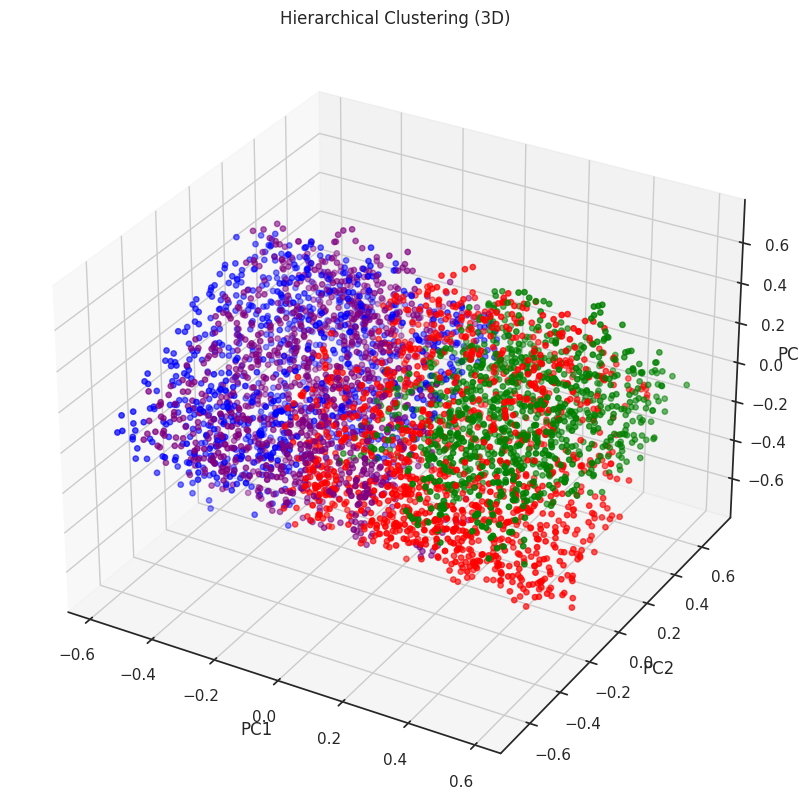

In [59]:
# Visualize the clustering results in 3D
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(df1_pca['PC1'], df1_pca['PC3'], df1_pca['PC4'], c=df1_pca['Cluster'], cmap=custom_cmap, s=15)
ax.set_title('Hierarchical Clustering (3D)')
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')

plt.show()

***Training the models on the data after hierarchical clustering and PCA***

Accuracy: 0.9110070257611241
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.88      0.88       318
           1       0.93      0.93      0.93       536

    accuracy                           0.91       854
   macro avg       0.90      0.91      0.90       854
weighted avg       0.91      0.91      0.91       854



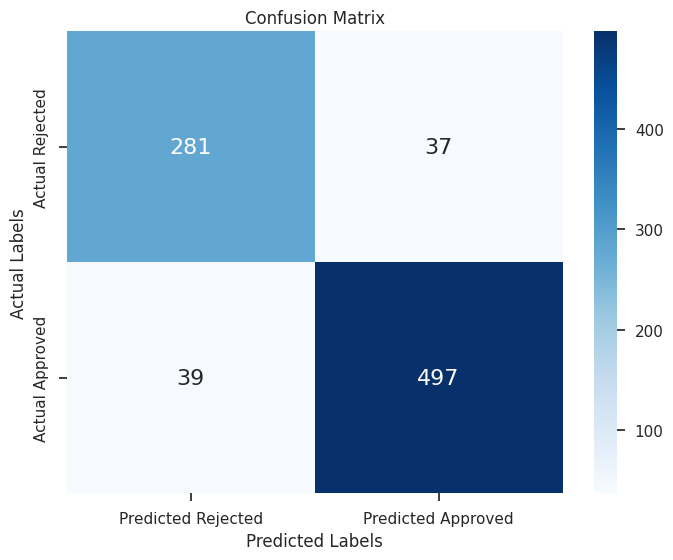

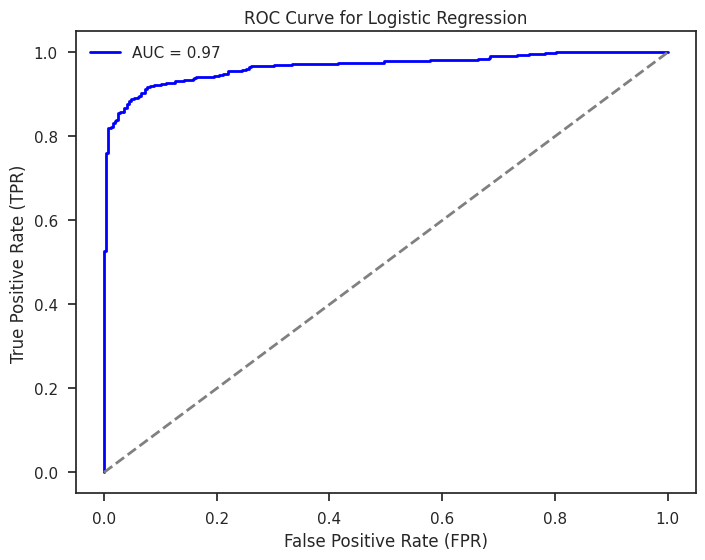

AUC: 0.97


In [60]:
# Prepare the data
X = df1_pca
Y = df['loan_status']

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Create and train a Logistic Regression model
log_model = LogisticRegression(random_state=42, multi_class='ovr', max_iter=1000)
log_model.fit(X_train, Y_train)

log_predictions = log_model.predict(X_test)


accuracy = accuracy_score(Y_test, log_predictions)
classification_rep = classification_report(Y_test, log_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)




conf_mat = confusion_matrix(Y_test, log_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])


plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = log_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Logistic Regression')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')


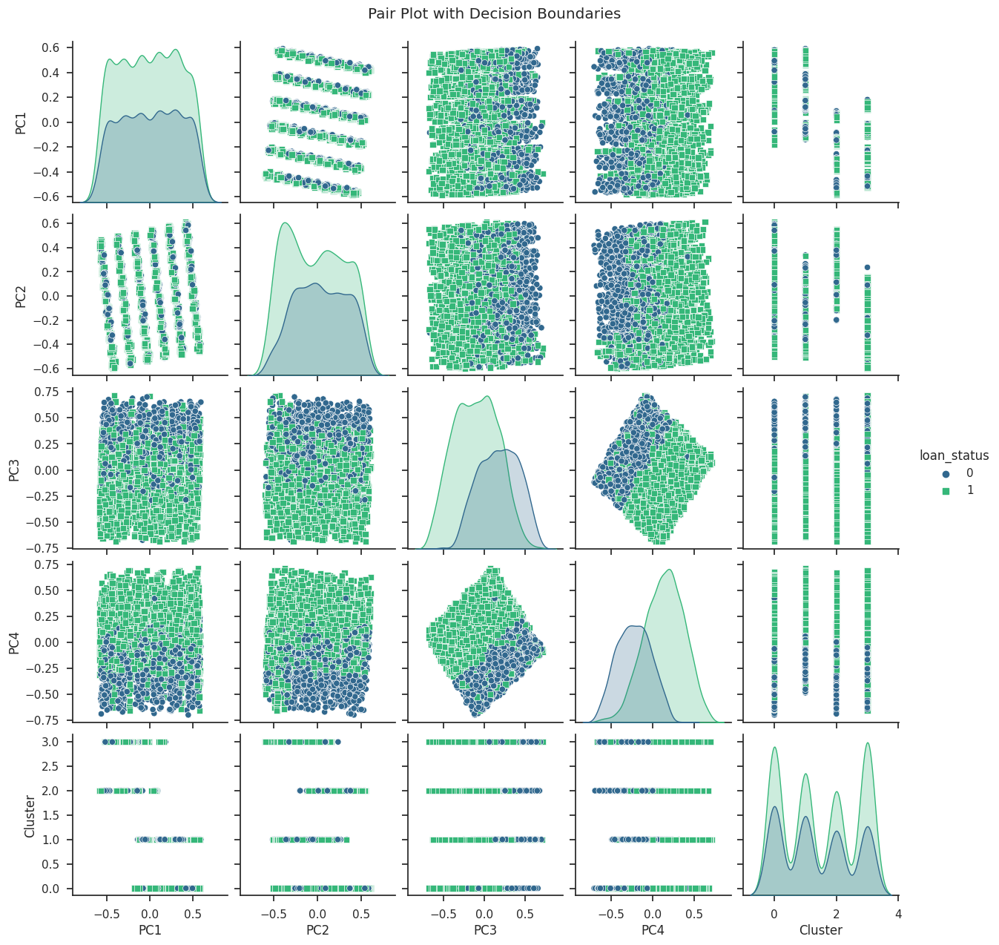

In [61]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Accuracy: 0.6276346604215457
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       318
           1       0.63      1.00      0.77       536

    accuracy                           0.63       854
   macro avg       0.31      0.50      0.39       854
weighted avg       0.39      0.63      0.48       854



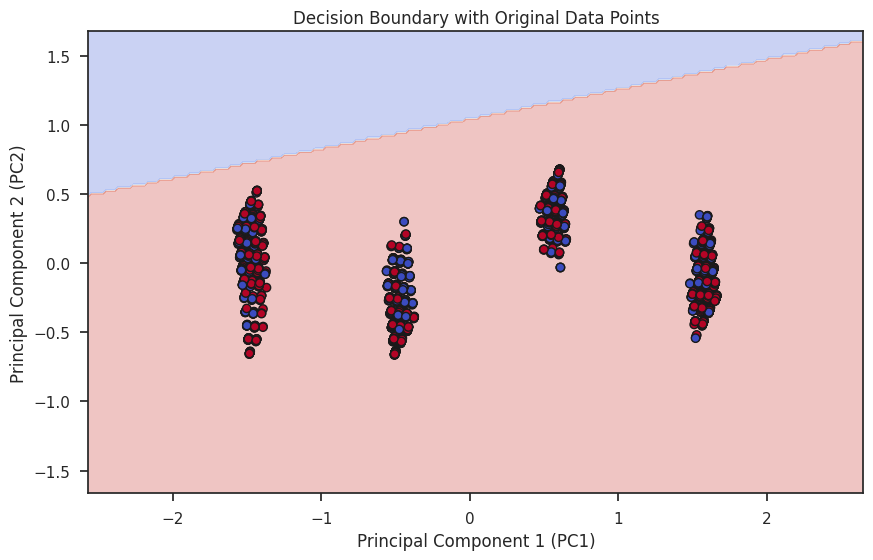

In [62]:
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

# Create and train a Logistic Regression model
log_model = LogisticRegression(random_state=42, multi_class='ovr', max_iter=1000)
log_model.fit(X_train, Y_train)

# Make predictions on the test set
log_predictions = log_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, log_predictions)
classification_rep = classification_report(Y_test, log_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot the decision boundary
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = log_model.predict(np.c_[xx.ravel(), yy.ravel()])


Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Boundary with Original Data Points')
plt.show()

Random Forest Accuracy: 0.9437939110070258
Random Forest Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.93      0.93       318
           1       0.96      0.95      0.95       536

    accuracy                           0.94       854
   macro avg       0.94      0.94      0.94       854
weighted avg       0.94      0.94      0.94       854



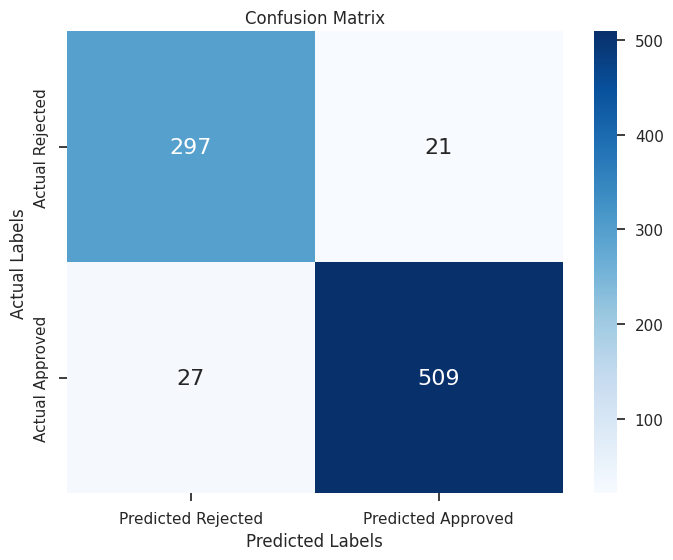

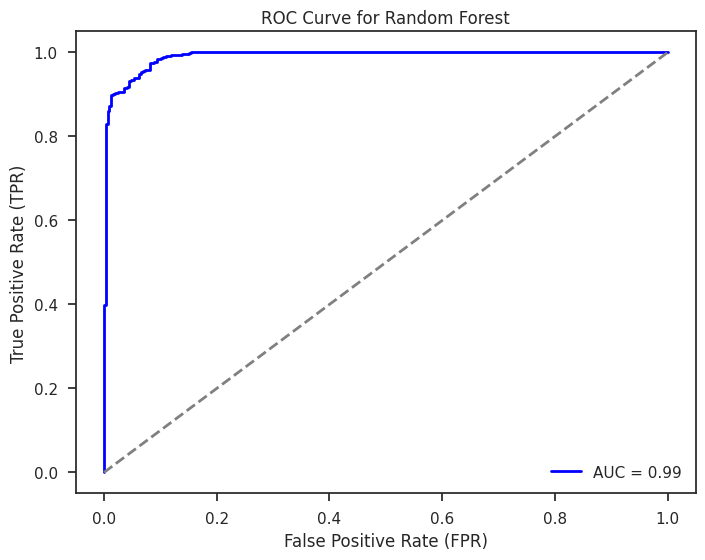

AUC: 0.99


In [63]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
X = df1_pca

Y = df['loan_status']

# Train-test split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

param_grid = {
    #'n_estimators': [50, 100, 200],
    # 'max_depth': [None, 10, 20],
    # 'min_samples_split': [2, 5, 10],
    # 'min_samples_leaf': [1, 2, 4],
    # 'max_features': ['auto', 'sqrt', 'log2'],
    # 'bootstrap': [True, False]
}

n_estimators = 100
max_depth = 10
min_samples_split = 5
# Create the RandomForestClassifier with the specified hyperparameters
rf_model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
rf_model.fit(X_train, Y_train)

#trying combinations of hyper-parameters for the best results
# grid_search = GridSearchCV(estimator=rf_classifier, param_grid=param_grid, cv=3, scoring='accuracy')
# grid_search.fit(X_train, Y_train)

# best_params = grid_search.best_params_
# print("Best Hyperparameters:", best_params)

# best_rf_model = RandomForestClassifier(**best_params, random_state=42)
# best_rf_model.fit(X_train, Y_train)

# Random Forest Classifier
#estimators = 100
# rf_model = RandomForestClassifier(random_state=42, n_estimators=100,criterion='gini')


# Predictions
rf_predictions = rf_model.predict(X_test)

# Evaluation
accuracy_rf = accuracy_score(Y_test, rf_predictions)
classification_rep_rf = classification_report(Y_test, rf_predictions)

print(f"Random Forest Accuracy: {accuracy_rf}")
print("Random Forest Classification Report:\n", classification_rep_rf)

conf_mat = confusion_matrix(Y_test, rf_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])

plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = rf_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Random Forest')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')



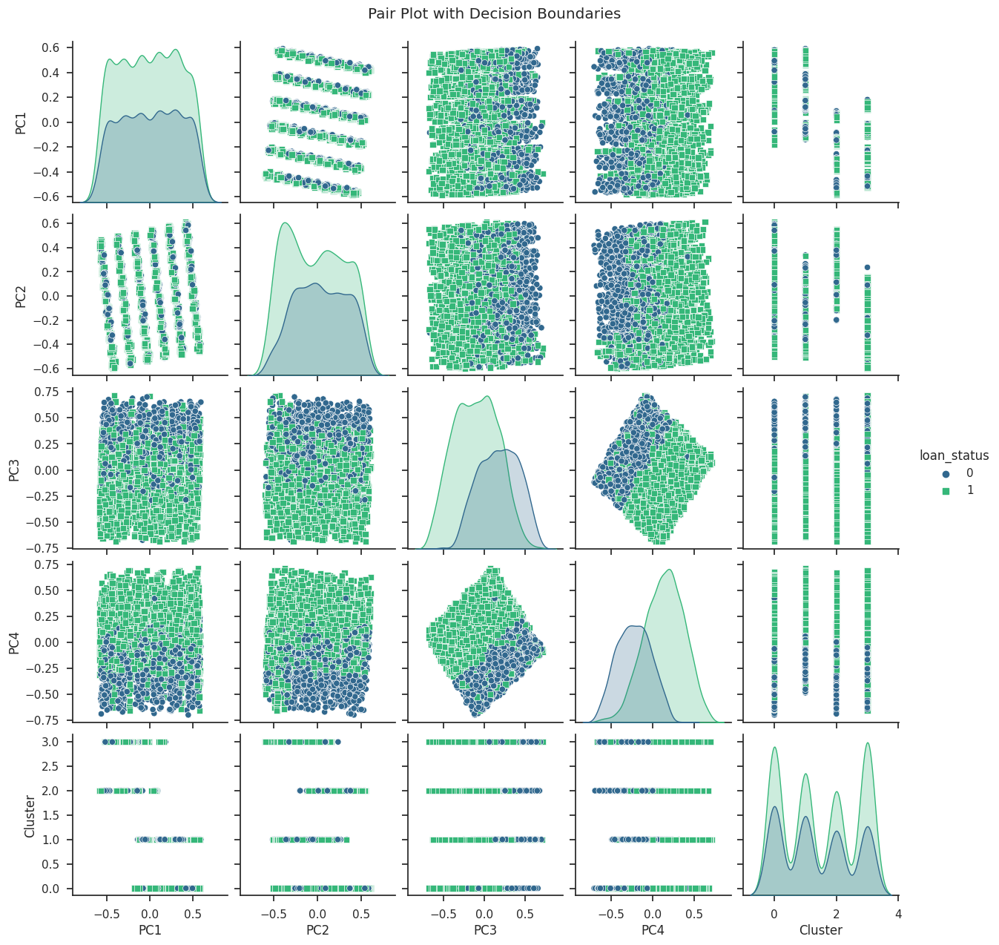

In [64]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

Accuracy: 0.8173302107728337
Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.65      0.73       318
           1       0.82      0.91      0.86       536

    accuracy                           0.82       854
   macro avg       0.82      0.78      0.79       854
weighted avg       0.82      0.82      0.81       854



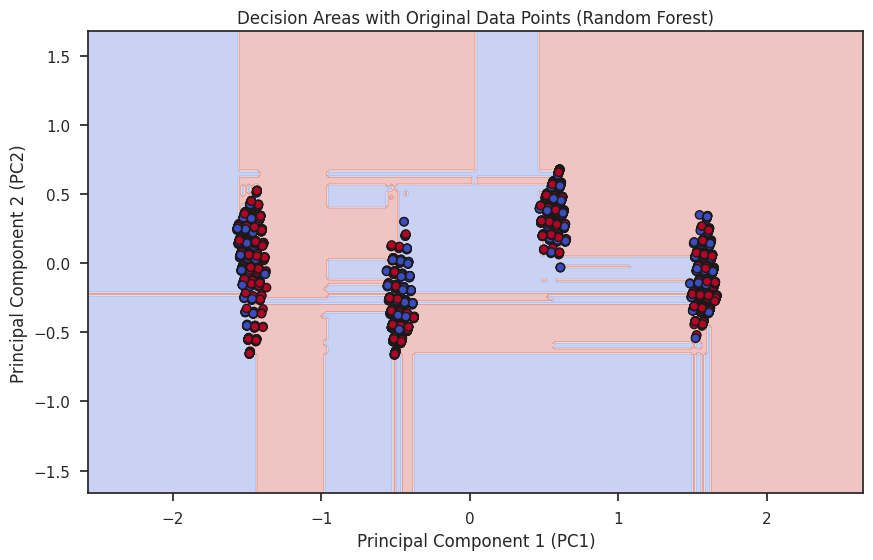

In [65]:
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

n_estimators = 100
max_depth = 10
min_samples_split = 5
# Create the RandomForestClassifier with the specified hyperparameters
rf_model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
rf_model.fit(X_train, Y_train)
rf_model.fit(X_train, Y_train)

# Make predictions on the test set
rf_predictions = rf_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, rf_predictions)
classification_rep = classification_report(Y_test, rf_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot decision areas
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = rf_model.predict(np.c_[xx.ravel(), yy.ravel()])

Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Areas with Original Data Points (Random Forest)')
plt.show()

Naive Bayes Accuracy: 0.9156908665105387
Naive Bayes Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.90      0.89       318
           1       0.94      0.93      0.93       536

    accuracy                           0.92       854
   macro avg       0.91      0.91      0.91       854
weighted avg       0.92      0.92      0.92       854



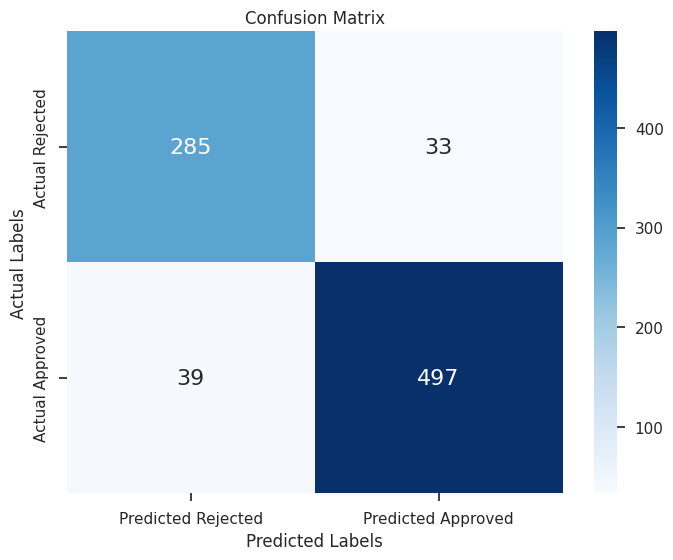

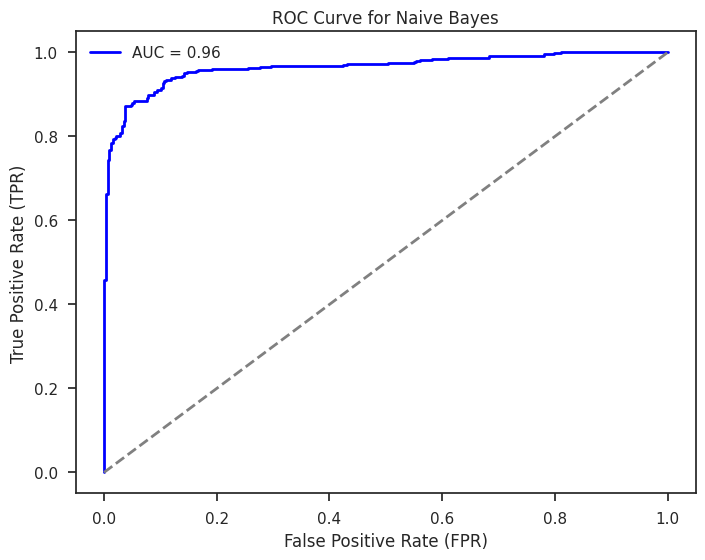

AUC: 0.96


In [66]:

X = df1_pca

Y = df['loan_status']

best_params = {'var_smoothing': 1e-09}
nb_model = GaussianNB(**best_params)

# param_grid = {
#     'var_smoothing': [1e-9, 1e-8, 1e-7, 1e-6, 1e-5]
# }

# grid_search = GridSearchCV(nb_model, param_grid, cv=5, scoring='accuracy', verbose=1)
# grid_search.fit(X_train, Y_train)

# best_params = grid_search.best_params_
# print("Best Hyperparameters:", best_params)

# best_gnb_model = grid_search.best_estimator_
# predictions = best_gnb_model.predict(X_test)

# Train-test split (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Gaussian Naive Bayes

nb_model.fit(X_train, Y_train)

# Predictions
nb_predictions = nb_model.predict(X_test)

# Evaluation
accuracy_nb = accuracy_score(Y_test, nb_predictions)
classification_rep_nb = classification_report(Y_test, nb_predictions)

print(f"Naive Bayes Accuracy: {accuracy_nb}")
print("Naive Bayes Classification Report:\n", classification_rep_nb)

conf_mat = confusion_matrix(Y_test, nb_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])
plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = nb_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Naive Bayes')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')


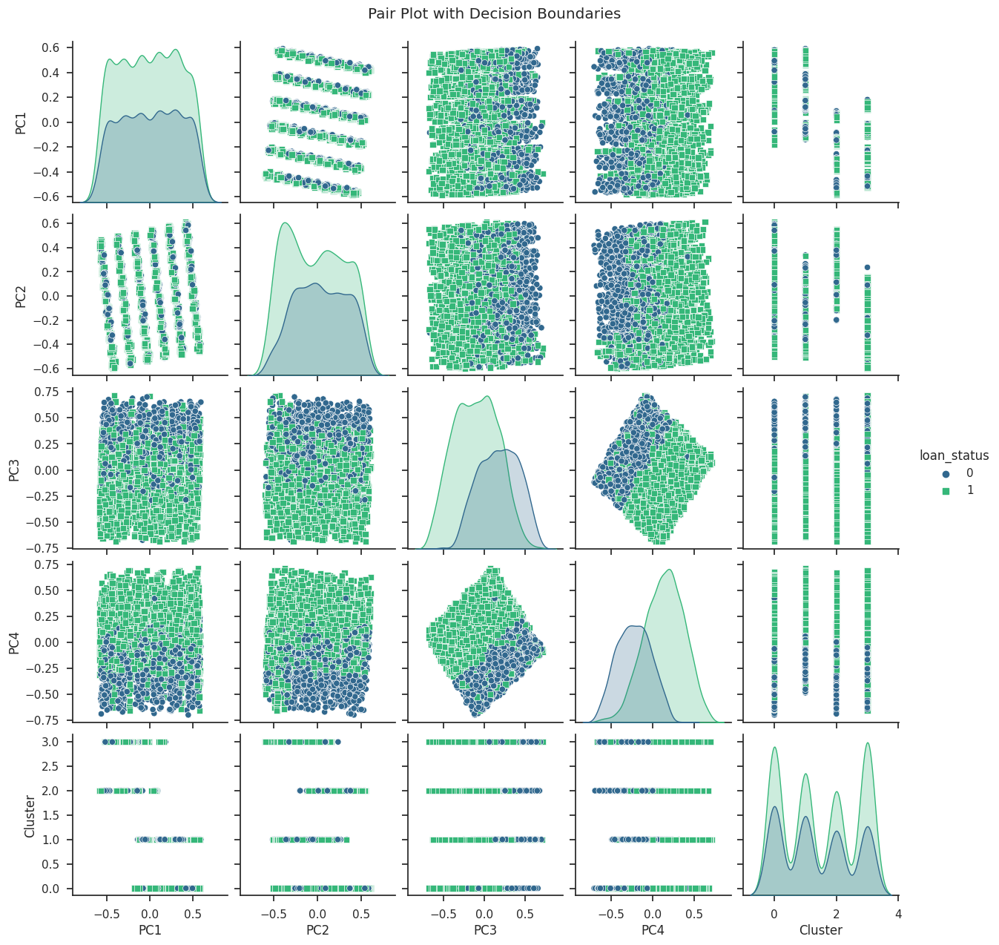

In [67]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Accuracy: 0.6276346604215457
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       318
           1       0.63      1.00      0.77       536

    accuracy                           0.63       854
   macro avg       0.31      0.50      0.39       854
weighted avg       0.39      0.63      0.48       854



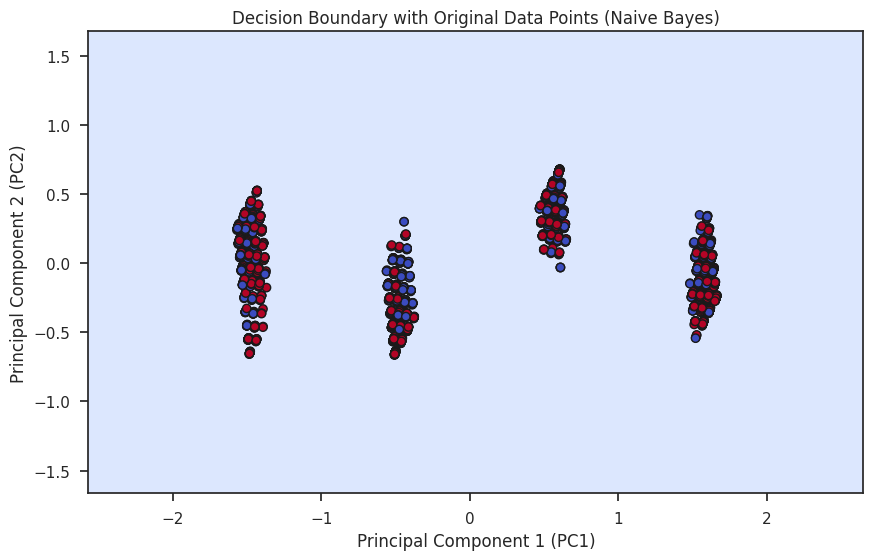

In [68]:
# Extract features and target variable
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

# Create and train a Gaussian Naive Bayes model
nb_model = GaussianNB()
nb_model.fit(X_train, Y_train)

# Make predictions on the test set
nb_predictions = nb_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, nb_predictions)
classification_rep = classification_report(Y_test, nb_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot the decision boundary
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = nb_model.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Boundary with Original Data Points (Naive Bayes)')
plt.show()

In [69]:
df1_pca = df1_pca.drop('Cluster',axis=1)

In [70]:
df1_pca.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   PC1     4269 non-null   float64
 1   PC2     4269 non-null   float64
 2   PC3     4269 non-null   float64
 3   PC4     4269 non-null   float64
dtypes: float64(4)
memory usage: 133.5 KB


# ***Creating and Visualizing the DBScan clustering***

Text(0, 0.5, 'Epsilon')

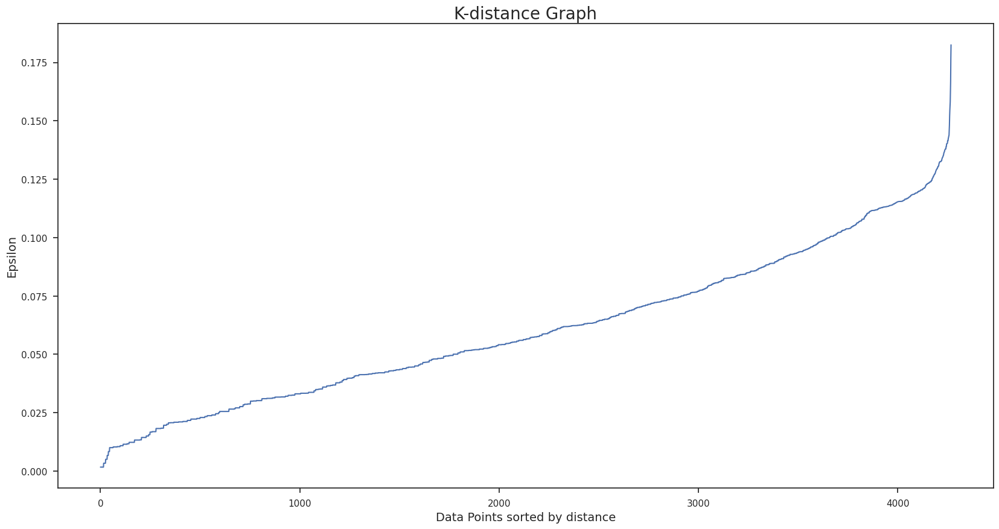

In [71]:
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(df1_pca)

# use kneighbors to find distances and indices of points for each point in dataset
distances, indices = nbrs.kneighbors(df1_pca)
distances, indices

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(20,10))
plt.plot(distances)
plt.title('K-distance Graph',fontsize=20)
plt.xlabel('Data Points sorted by distance',fontsize=14)
plt.ylabel('Epsilon',fontsize=14)



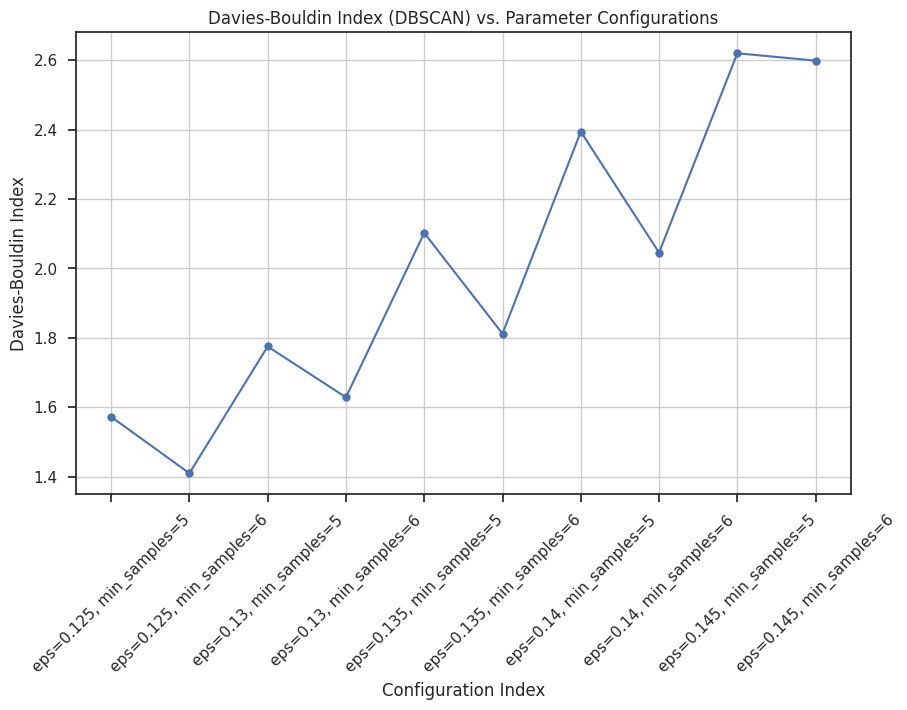

In [72]:
def calculate_davies_bouldin_scores_dbscan(data, eps_values, min_samples_values):
    davies_bouldin_scores = []

    for eps in eps_values:
        for min_samples in min_samples_values:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)
            labels = dbscan.fit_predict(data)
            davies_bouldin_scores.append(davies_bouldin_score(data, labels))

    return davies_bouldin_scores

# Example values for eps and min_samples
eps_values = [0.125,0.130,0.135,0.140,0.145]
min_samples_values = [5, 6]

davies_bouldin_scores_dbscan = calculate_davies_bouldin_scores_dbscan(X, eps_values, min_samples_values)

# Plot the Davies-Bouldin Index for DBSCAN
plt.figure(figsize=(10, 6))
plt.plot(range(len(davies_bouldin_scores_dbscan)), davies_bouldin_scores_dbscan, marker='o', linestyle='-', color='b')
plt.title('Davies-Bouldin Index (DBSCAN) vs. Parameter Configurations')
plt.xlabel('Configuration Index')
plt.ylabel('Davies-Bouldin Index')
plt.xticks(range(len(davies_bouldin_scores_dbscan)), [f'eps={eps}, min_samples={min_samples}' for eps in eps_values for min_samples in min_samples_values], rotation=45)
plt.grid(True)
plt.show()

In [73]:
dbscan_opt=DBSCAN(eps=0.13,min_samples=5)
dbscan_opt.fit(df1_pca)
df1_pca['Cluster']=dbscan_opt.labels_

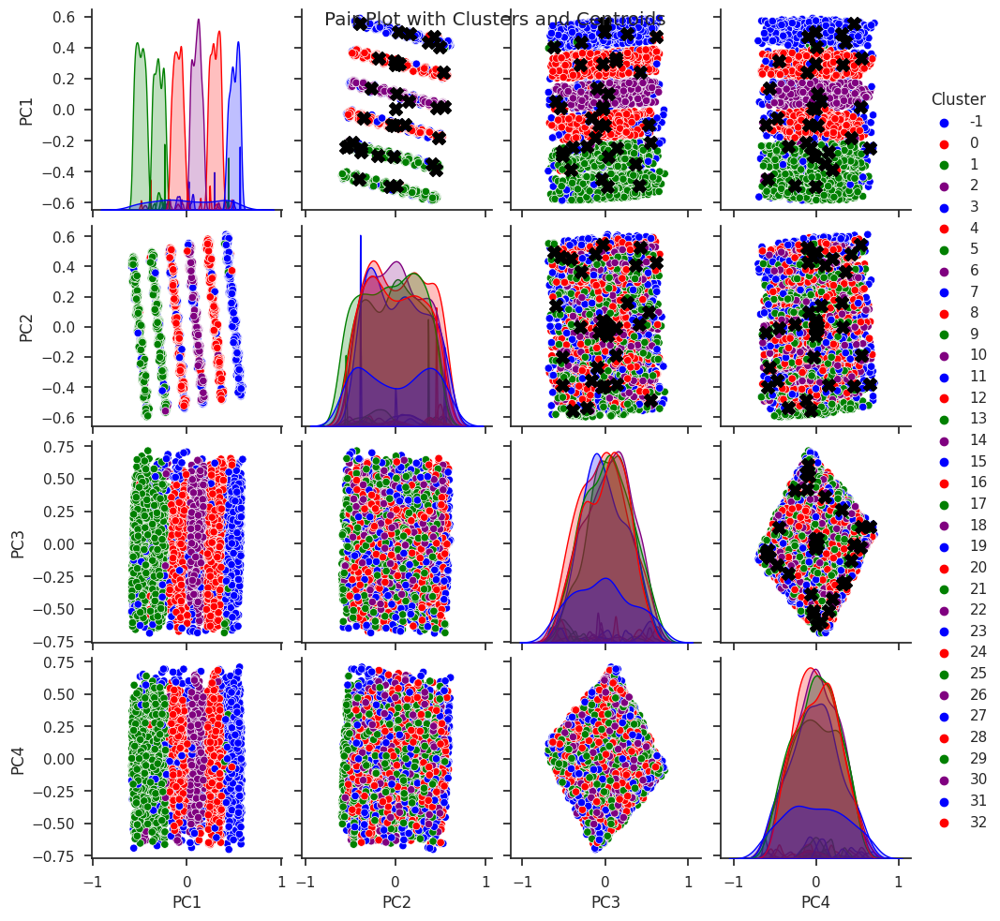

In [74]:
# Create a pair plot for all principal components
selected_columns = ['PC1', 'PC2', 'PC3', 'PC4']
pairplot_data = X[selected_columns].copy()
pairplot_data['Cluster'] = df1_pca['Cluster']


custom_palette = sns.color_palette(['blue', 'red', 'green', 'purple'], n_colors=len(pairplot_data['Cluster'].unique()))

# Use Seaborn pairplot with the custom color palette
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='Cluster', palette=custom_palette, markers='o', diag_kind='kde')

# Plot centroids for each cluster on each subplot
centroids = kmeans.cluster_centers_
unique_cluster_ids = pairplot_data['Cluster'].unique()
for cluster_id, color in zip(unique_cluster_ids, custom_palette):
    cluster_indices = np.where(pairplot_data['Cluster'] == cluster_id)[0]
    if len(cluster_indices) > 0:
        cluster_centroid = pairplot_data.iloc[cluster_indices].mean(axis=0).values[:-1]
    else:
        cluster_centroid = centroids[cluster_id]

    # Plot centroid on each subplot
    for i, j in zip(*np.triu_indices_from(g.axes, 1)):
        g.axes[i, j].scatter(cluster_centroid[j], cluster_centroid[i], s=100, c='black', marker='X', label=f'Centroid - Cluster {cluster_id}')

plt.suptitle('Pair Plot with Clusters and Centroids')
plt.show()


Text(0, 0.5, 'Feature 2')

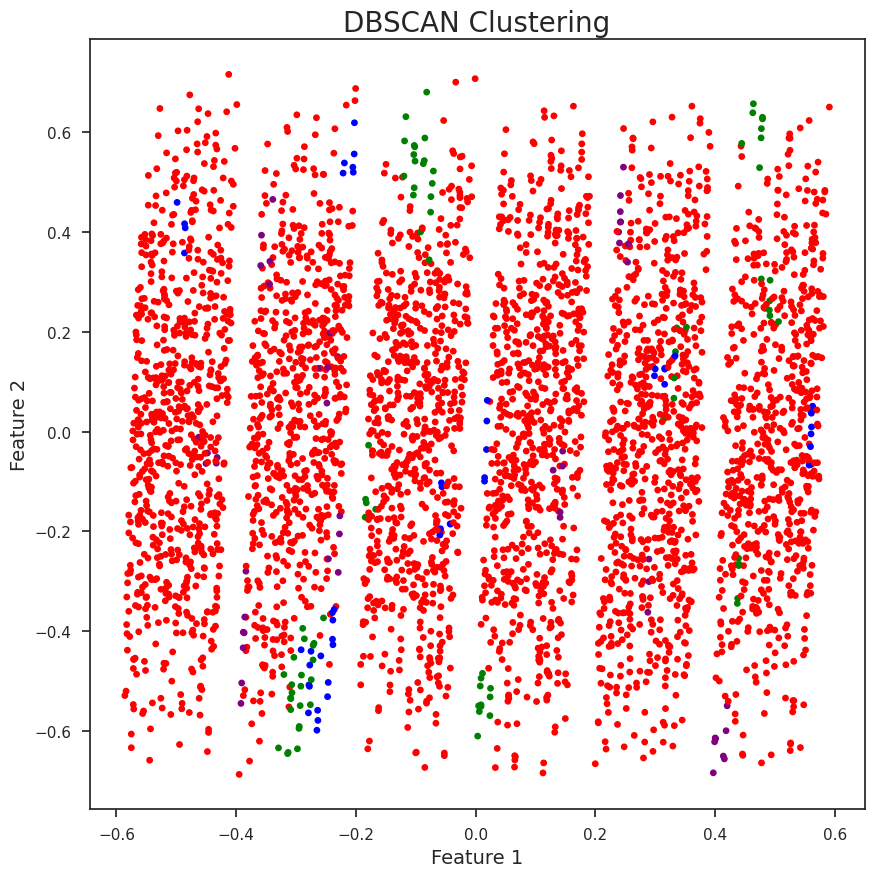

In [75]:
plt.figure(figsize=(10,10))
plt.scatter(df1_pca['PC1'],df1_pca['PC3'],c=df1_pca['Cluster'],cmap=matplotlib.colors.ListedColormap(colors),s=15)
plt.title('DBSCAN Clustering',fontsize=20)
plt.xlabel('Feature 1',fontsize=14)
plt.ylabel('Feature 2',fontsize=14)

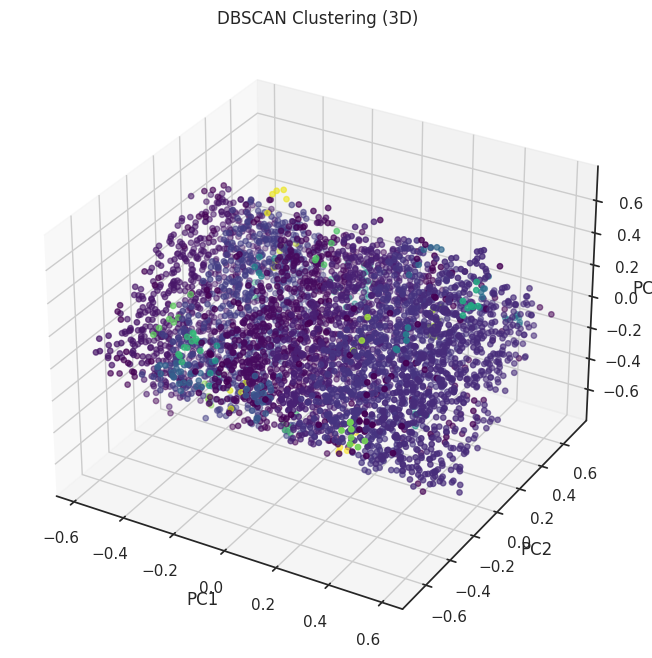

In [76]:
X = df1_pca[['PC1', 'PC2', 'PC3', 'PC4']]

# Perform DBSCAN clustering
eps_value = 0.13  # Adjust based on your analysis
min_samples_value = 5
dbscan_opt = DBSCAN(eps=eps_value, min_samples=min_samples_value)
df1_pca['Cluster'] = dbscan_opt.fit_predict(X)

# Create a 3D scatter plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with cluster assignments
ax.scatter(df1_pca['PC1'], df1_pca['PC3'], df1_pca['PC4'], c=df1_pca['Cluster'], cmap='viridis', s=15)

# Set axis labels
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')

# Set plot title
ax.set_title('DBSCAN Clustering (3D)')

plt.show()

***Training the model after doing DBScan clustering and PCA***

Accuracy: 0.914519906323185
Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.88      0.88       318
           1       0.93      0.93      0.93       536

    accuracy                           0.91       854
   macro avg       0.91      0.91      0.91       854
weighted avg       0.91      0.91      0.91       854



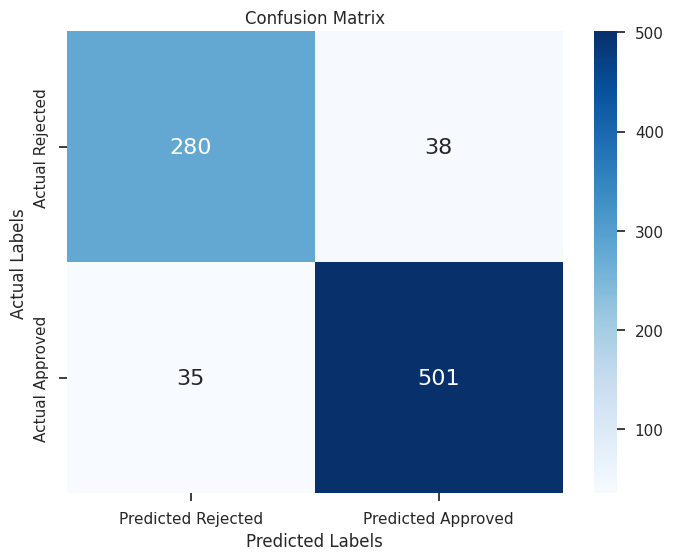

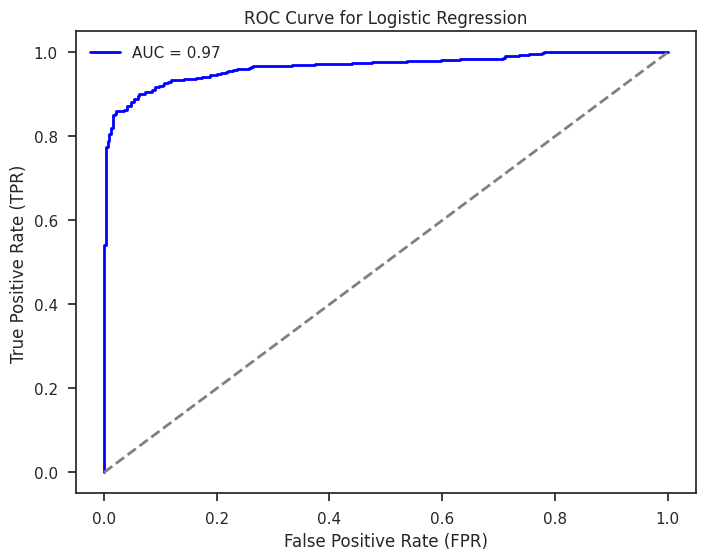

AUC: 0.97


In [77]:
# Prepare the data
X = df1_pca
Y = df['loan_status']

# testing
# param_grid = {
#     'penalty': ['l1', 'l2'],         # Regularization term
#     'C': [0.001, 0.01, 0.1, 1, 10],   # Inverse of regularization strength
#     'solver': ['liblinear', 'saga'], # Algorithm to use in optimization
#     'max_iter': [100, 200, 1000]       # Maximum number of iterations
# }

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Create and train a Logistic Regression model
log_model = LogisticRegression(random_state=42, multi_class='ovr', max_iter=1000)
log_model.fit(X_train, Y_train)

log_predictions = log_model.predict(X_test)

# grid_search = GridSearchCV(log_model, param_grid, cv=5, scoring='accuracy', verbose=1)
# grid_search.fit(X_train, Y_train)

# best_params = grid_search.best_params_
# print("Best Hyperparameters:", best_params)

# best_logreg_model = grid_search.best_estimator_
# predictions = best_logreg_model.predict(X_test)

accuracy = accuracy_score(Y_test, log_predictions)
classification_rep = classification_report(Y_test, log_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)




conf_mat = confusion_matrix(Y_test, log_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])


plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = log_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Logistic Regression')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')


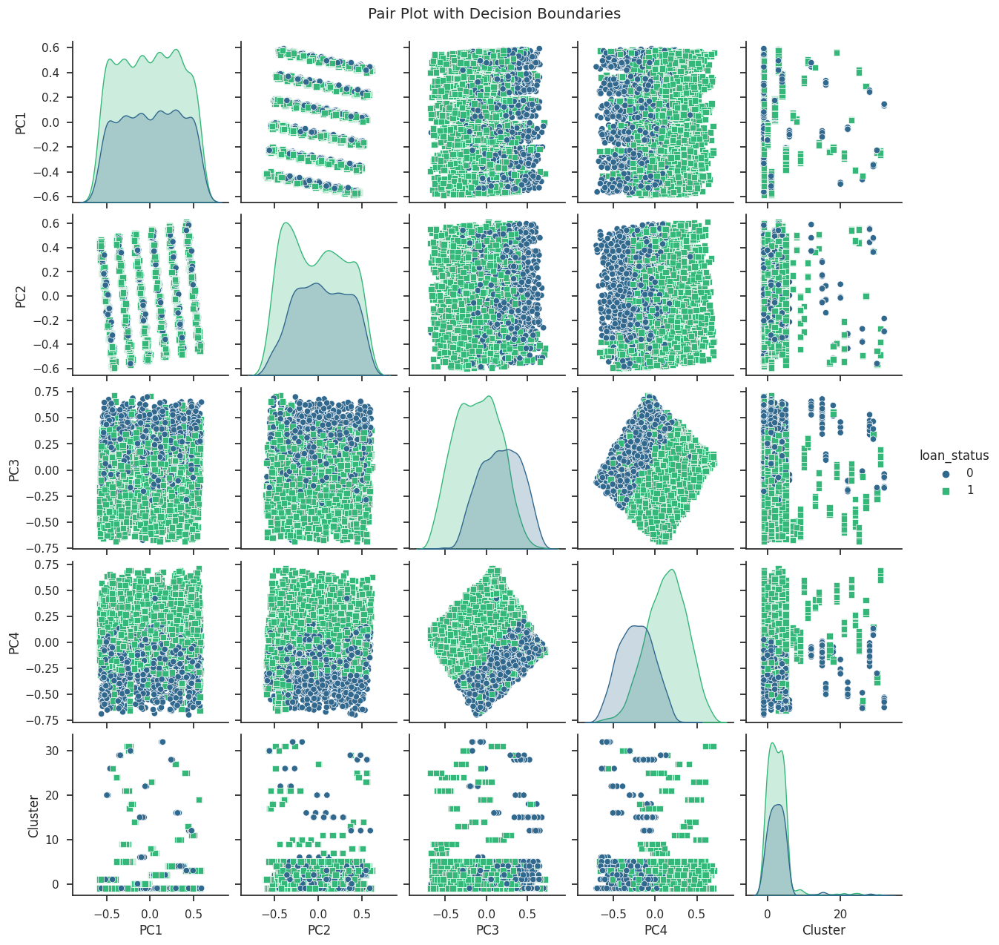

In [78]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Accuracy: 0.6276346604215457
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       318
           1       0.63      1.00      0.77       536

    accuracy                           0.63       854
   macro avg       0.31      0.50      0.39       854
weighted avg       0.39      0.63      0.48       854



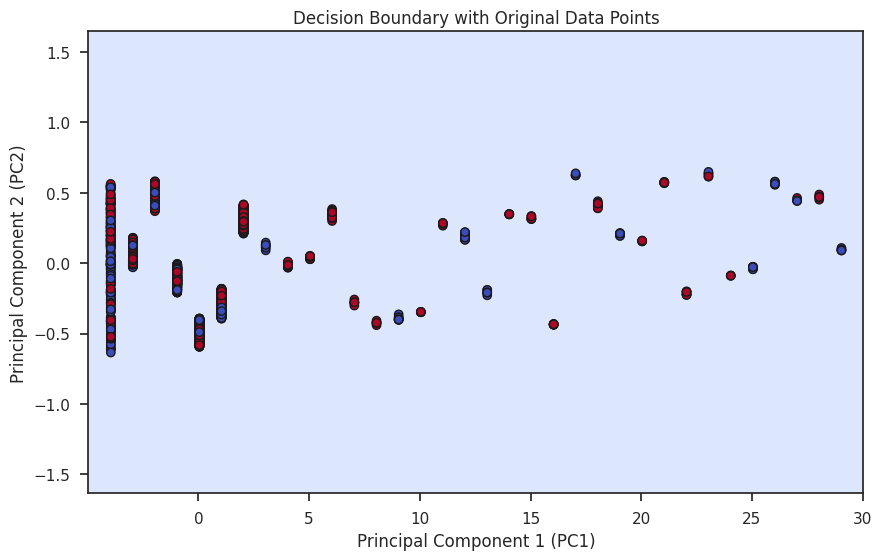

In [79]:
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

# Create and train a Logistic Regression model
log_model = LogisticRegression(random_state=42, multi_class='ovr', max_iter=1000)
log_model.fit(X_train, Y_train)

# Make predictions on the test set
log_predictions = log_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, log_predictions)
classification_rep = classification_report(Y_test, log_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot the decision boundary
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = log_model.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Boundary with Original Data Points')
plt.show()

Random Forest Accuracy: 0.9473067915690867
Random Forest Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.94      0.93       318
           1       0.96      0.95      0.96       536

    accuracy                           0.95       854
   macro avg       0.94      0.95      0.94       854
weighted avg       0.95      0.95      0.95       854



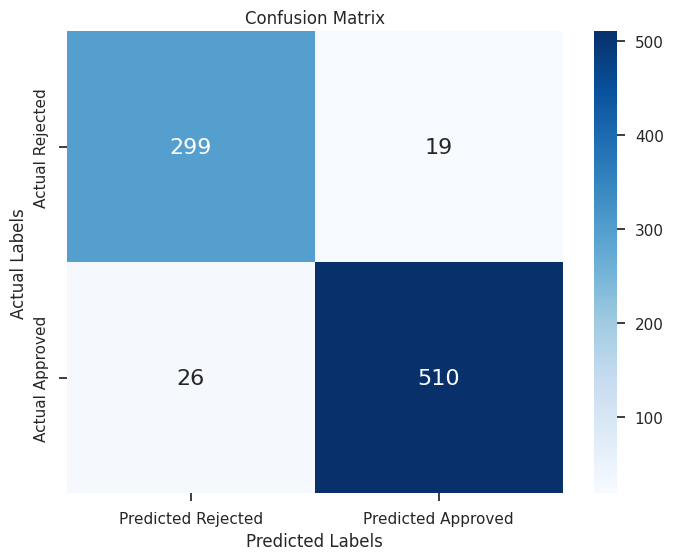

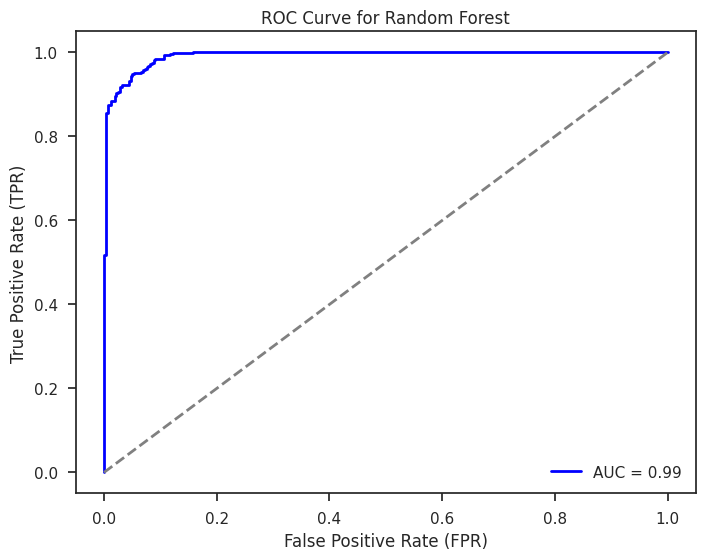

AUC: 0.99


In [80]:
from sklearn.ensemble import RandomForestClassifier

X = df1_pca

Y = df['loan_status']

# Train-test split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

n_estimators = 100
max_depth = 10
min_samples_split = 5
# Create the RandomForestClassifier with the specified hyperparameters
rf_model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
rf_model.fit(X_train, Y_train)
rf_model.fit(X_train, Y_train)

# Predictions
rf_predictions = rf_model.predict(X_test)

# Evaluation
accuracy_rf = accuracy_score(Y_test, rf_predictions)
classification_rep_rf = classification_report(Y_test, rf_predictions)

print(f"Random Forest Accuracy: {accuracy_rf}")
print("Random Forest Classification Report:\n", classification_rep_rf)

conf_mat = confusion_matrix(Y_test, rf_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])

plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = rf_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Random Forest')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')



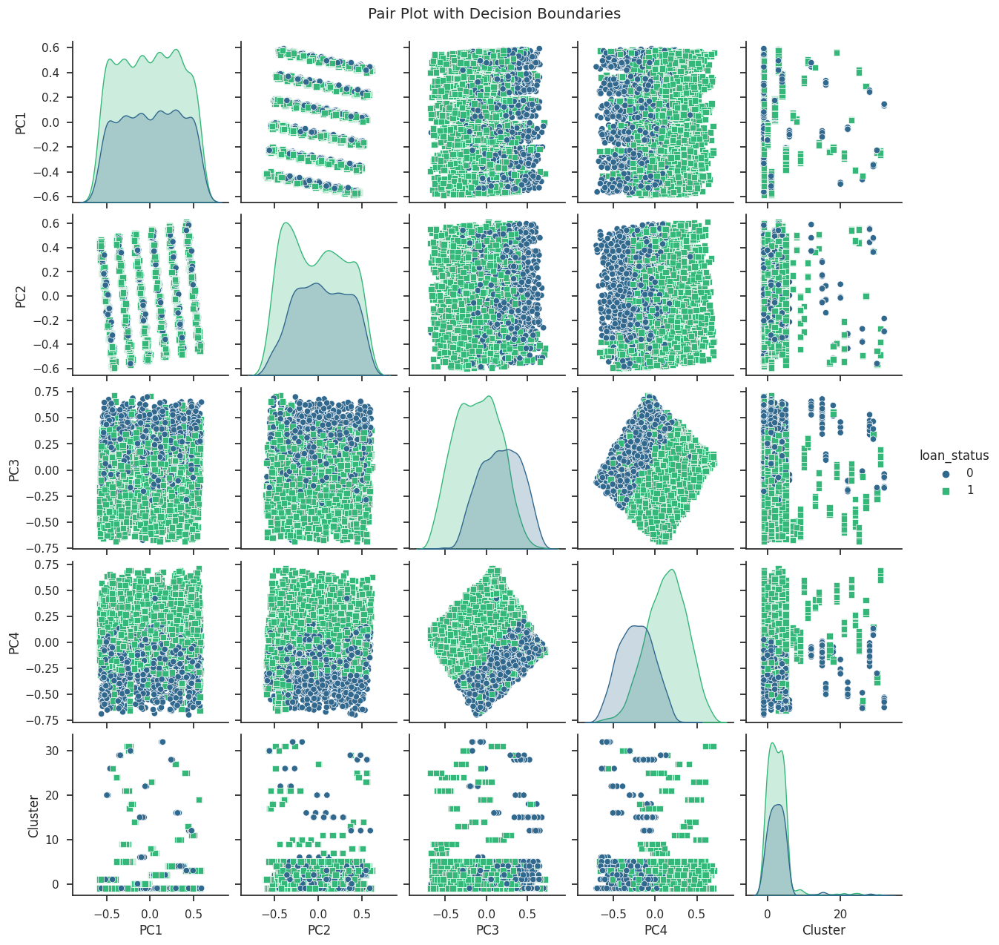

In [81]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

Accuracy: 0.6779859484777517
Classification Report:
               precision    recall  f1-score   support

           0       0.75      0.20      0.32       318
           1       0.67      0.96      0.79       536

    accuracy                           0.68       854
   macro avg       0.71      0.58      0.55       854
weighted avg       0.70      0.68      0.61       854



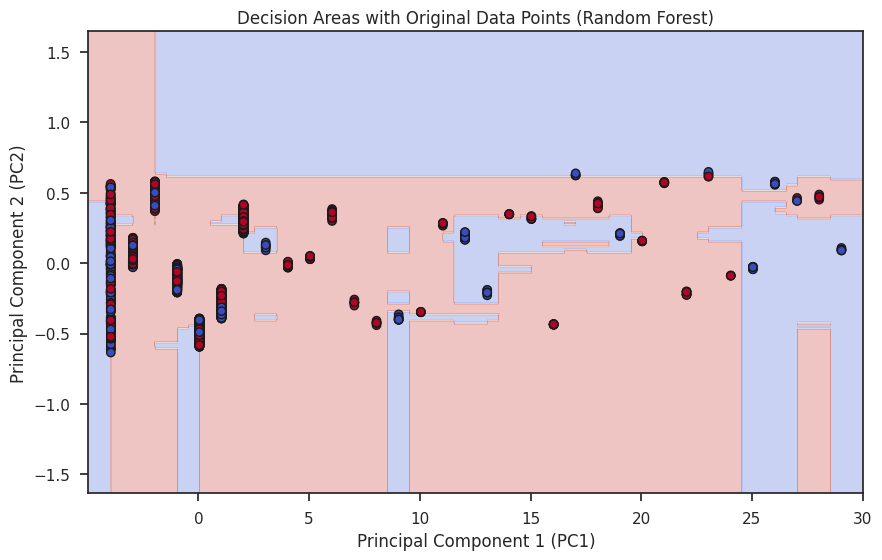

In [82]:
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

n_estimators = 100
max_depth = 10
min_samples_split = 5
# Create the RandomForestClassifier with the specified hyperparameters
rf_model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
rf_model.fit(X_train, Y_train)
rf_model.fit(X_train, Y_train)

# Make predictions on the test set
rf_predictions = rf_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, rf_predictions)
classification_rep = classification_report(Y_test, rf_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot decision areas
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = rf_model.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Areas with Original Data Points (Random Forest)')
plt.show()

Naive Bayes Accuracy: 0.9168618266978923
Naive Bayes Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.89      0.89       318
           1       0.94      0.93      0.93       536

    accuracy                           0.92       854
   macro avg       0.91      0.91      0.91       854
weighted avg       0.92      0.92      0.92       854



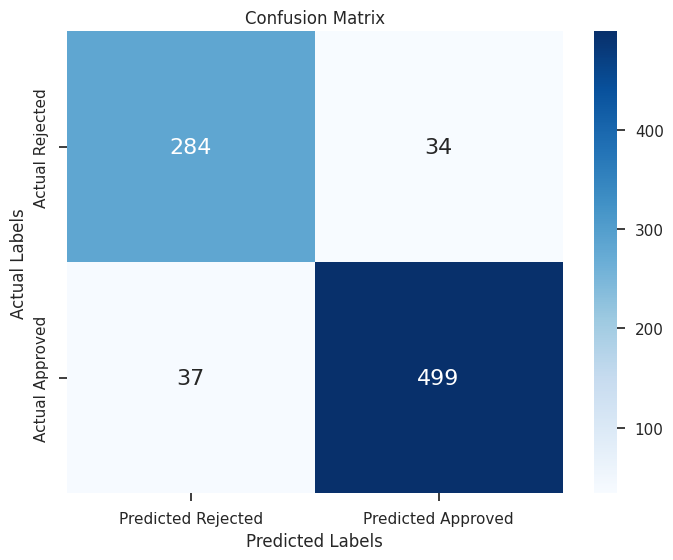

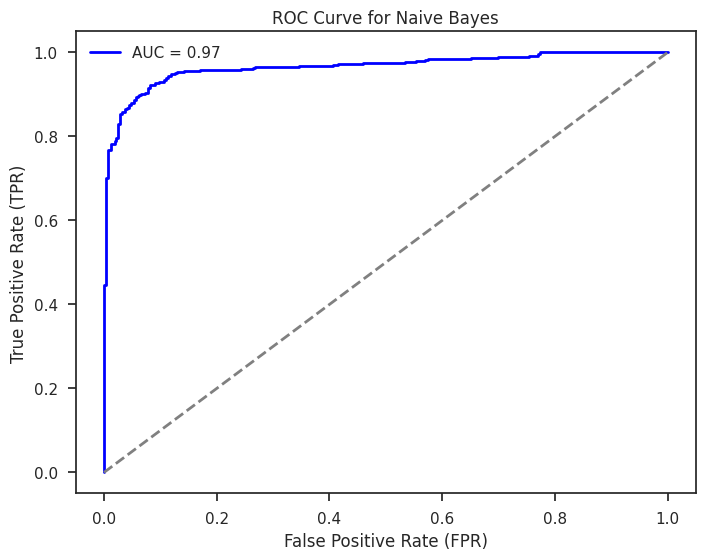

AUC: 0.97


In [83]:

X = df1_pca

Y = df['loan_status']
#hyper parameters
best_params = {'var_smoothing': 1e-09}
nb_model = GaussianNB(**best_params)

# param_grid = {
#     'var_smoothing': [1e-9, 1e-8, 1e-7, 1e-6, 1e-5]
# }


# grid_search = GridSearchCV(nb_model, param_grid, cv=5, scoring='accuracy', verbose=1)
# grid_search.fit(X_train, Y_train)

# best_params = grid_search.best_params_
# print("Best Hyperparameters:", best_params)

# best_gnb_model = grid_search.best_estimator_
# predictions = best_gnb_model.predict(X_test)

# Train-test split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Gaussian Naive Bayes

nb_model.fit(X_train, Y_train)

# Predictions
nb_predictions = nb_model.predict(X_test)

# Evaluation
accuracy_nb = accuracy_score(Y_test, nb_predictions)
classification_rep_nb = classification_report(Y_test, nb_predictions)

print(f"Naive Bayes Accuracy: {accuracy_nb}")
print("Naive Bayes Classification Report:\n", classification_rep_nb)

conf_mat = confusion_matrix(Y_test, nb_predictions)

conf_frame = pd.DataFrame(conf_mat,
                           columns=['Predicted Rejected', 'Predicted Approved'],
                           index=['Actual Rejected', 'Actual Approved'])
plt.figure(figsize=(8, 6))
sns.heatmap(conf_frame, annot=True, fmt='d', annot_kws={"size": 16}, cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.show()

nb_probs = nb_model.predict_proba(X_test)[:, 1]

# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, nb_probs)

# Calculate the AUC
auc = roc_auc_score(Y_test, nb_probs)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', lw=2)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Naive Bayes')
plt.legend()
plt.show()

print(f'AUC: {auc:.2f}')


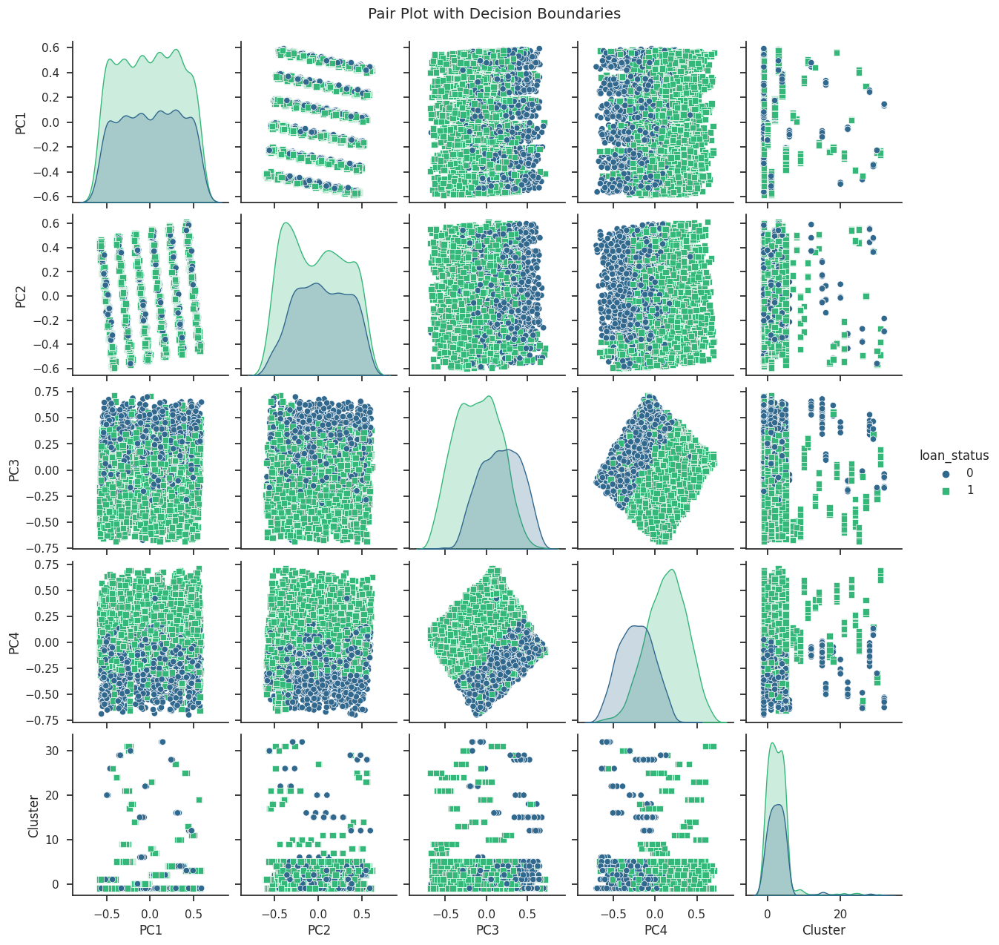

In [84]:
pairplot_data = pd.concat([X, Y], axis=1)

# Visualize decision boundaries along with original data points
sns.set(style="ticks")
g = sns.pairplot(pairplot_data, hue='loan_status', palette='viridis', markers=["o", "s"], diag_kind='kde')
g.fig.suptitle("Pair Plot with Decision Boundaries", y=1.02)
plt.show()

PCA was done to reduce the components to 2 to test the decision boundary

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Accuracy: 0.6276346604215457
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       318
           1       0.63      1.00      0.77       536

    accuracy                           0.63       854
   macro avg       0.31      0.50      0.39       854
weighted avg       0.39      0.63      0.48       854



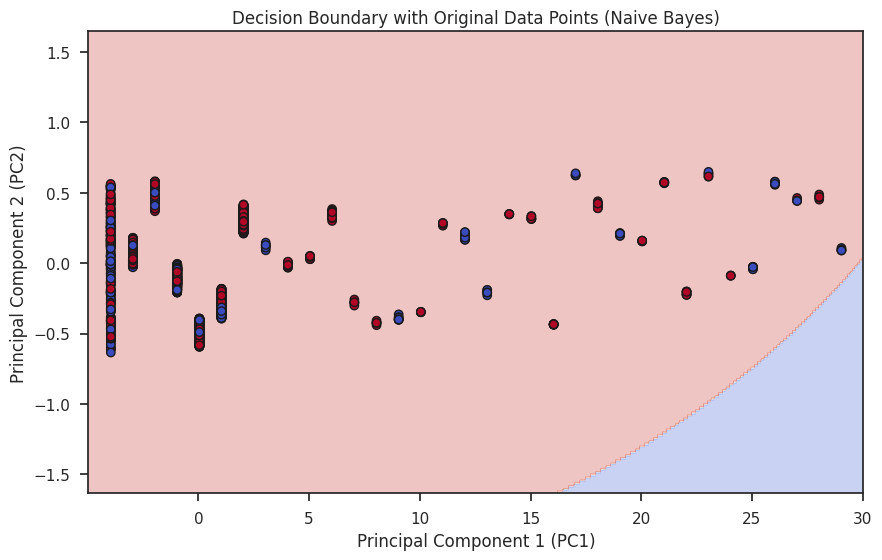

In [85]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report

# Assuming df1_pca and df are defined

# Extract features and target variable
X = df1_pca
Y = df['loan_status']

# Perform PCA with two components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Split the data into training and testing sets (80:20)
X_train, X_test, Y_train, Y_test = train_test_split(X_pca, Y, test_size=0.2, random_state=42)

# Create and train a Gaussian Naive Bayes model
nb_model = GaussianNB()
nb_model.fit(X_train, Y_train)

# Make predictions on the test set
nb_predictions = nb_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(Y_test, nb_predictions)
classification_rep = classification_report(Y_test, nb_predictions)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification_rep)

# Plot the decision boundary
h = .02  # step size in the mesh
x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = nb_model.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(figsize=(10, 6))
plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)

# Plot data points
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=Y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.xlabel('Principal Component 1 (PC1)')
plt.ylabel('Principal Component 2 (PC2)')
plt.title('Decision Boundary with Original Data Points (Naive Bayes)')
plt.show()